# Medical Imaging - Camelyon 16 challenge
Instructor: Prof. Josh Gordon

Team: Beichun Qi (bq2139), Boxi Xia (bx2150)



## Project Overview

Visual inspection of whole-slide images created from tissue samples is the most common way of detecting breast cancer metastases. However, it can be a tedious job because tissue samples are volumes. One tissue sample can be sliced to produce many tissue images for pathologists to inspect, while tumors are usually very small compared to a whole slide. This can cause fatigue and mistakes. Also, visual inspection requires expertise, which is rare.

Our goal is to develop a tool that can radically reduce the workload of pathologists and the misdiagnosis rate for common diagnostic tasks using mostly off the shelf software and well-known algorithms. Considering the recent achievements of deep neural networks in various image classification tasks, we decided to build a deep neural network to classify the slide images. The prediction of the neural network can form a second opinion for a pathologist - the opinion is to assist, not to replace pathologists.

To approach our goal, we first investigated the training data. We examined a few slide examples and found that tumor cells are always inside tissue cells, and often a large portion of the slide has no tissue (looks clean). We thus created the tissue masks for the slides images to exclude the non-tissue area. We generated tissue masks for level 1 slides, which is our target resolution level, based on level 8 slide images, since a 128 * 128 patch in level 1 corresponds to one pixel in level 8. We also slices the whole images down to small image patches (256 * 256) for our furture network to process. Then, our target is down to the tissue patches.

However, the number of tumor patches to normal (non-tumor) patches are still extremely imbalanced, so we took some steps to deal with the imbalanced data. First, we downloaded all the camelyon dataset and used ASAP to extract slide images (code in [preprocess_mask](./preprocess_mask.ipynb)). Doing so, we gathered more tumor patches, but training data is still imbalanced. So we used all the tumor patches and randomly sampled normal patches. Finally, we used data augmentation on the tumor patches. This includes random rotation, flip, hue, saturation, contrast and brightness. After those steps, we ensured that the number of tumor patches are comparative to normal patches.

Because the size of training data is huge, loading the image patches while training is expensive and would be an inefficient use of training time. To combat this problem, we utilized TFRecords to generate TFRecord dataset files (243GB training/2.5GB testing) from preprocessed image patches. Data augmentation was performed during training, which include random rotation / flip / hue / saturation / contrast / brightness.

We used the existing Xception model with a dense layer as our baseline model. Trained from fresh start, the baseline achieved 96% training accuracy and 97% validation accuracy after 150 epochs. Using trained weights achieve slightly better result with only 50 epochs. We also tried replacing all relu activations with selu activation, but the result showed no favor for the latter.

Another experiment we did was octave convolution. We compared MobilenetV2 (using lightweight depthwise convolution by default) and Resnet50 with its convolution layer replaced by octave convolution The experiment achieved training accuracy of 96% and 97% respectively, and validation accuracy of 97% both. We ploted the confusion matrix for every model.

We assembled the above steps to an end-to-end pipeline by performing the final step: ploting the probability heatmap of the slide. The heatmap shows clearly the tumor regions while also being conservative about the areas where it is unsure about.

#### [Video demo and code walkthrough](https://youtu.be/zNceQO2JufE)
#### [Presentation slide](https://docs.google.com/presentation/d/1Yye1DRUDKNhzQajRYWWpdWxQ2qzykBneF6fVFpErjPA/edit?usp=sharing)
#### [Github repository: /bq2139/medical-imaging-project](https://github.com/bq2139/medical-imaging-project)

### Reference
+ [CAMELYON16](https://camelyon17.grand-challenge.org/Data/)
+ [OpenSlide](https://openslide.org/)
+ [DeepZoom viewer](https://github.com/openslide/openslide-python/tree/master/examples/deepzoom)
+ [Detecting Cancer Metastases on Gigapixel Pathology Images](https://arxiv.org/abs/1703.02442)
+ [Octave convolution paper](https://arxiv.org/abs/1904.05049)
+ [Octave convolution keras code](https://github.com/titu1994/keras-octconv)

In [254]:
from scipy.ndimage import morphology
import tensorflow as tf
import itertools
import glob
from skimage.color import rgb2gray
from PIL import Image
import os
from openslide import open_slide, __library_version__ as openslide_version
import random
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
print('run utility cell')
# Install the OpenSlide C library and Python bindings
# !sudo apt-get install openslide-tools
# !pip install openslide-python
# !pip install joblib
%matplotlib inline


print('openslide version:', openslide_version)

plt.style.use('seaborn-paper')

########################################################


def read_slide(slide, x, y, level, width, height):
    """
    Read a region from the slide
    Return a numpy RBG array
    Input:
        slide_path (str): the path of the whole slide
        x (int): x position at level 0
        y (int): y position at level 0
        level(int): zoom level of the region
        width (int): width of the image at level=level 
        height (int): height of the image at level=level 
    """
    im = slide.read_region((x, y), level, (width, height))
    im = im.convert('RGB')  # drop the alpha channel
    im = np.asarray(im)
#     assert im.shape == (height, width, 3)
    return im


def read_slide_raw(slide, x, y, level, width, height):
    """
    Read a region from the slide
    Return a PIL image
    Input:
        slide_path (str): the path of the whole slide
        x (int): x position at level 0
        y (int): y position at level 0
        level(int): zoom level of the region
        width (int): width of the image at level=level 
        height (int): height of the image at level=level 
    """
    im = slide.read_region((x, y), level, (width, height)).convert(
        'RGB')  # drop the alpha channel
    return im


def get_tissue_mask(slide, base_level=1, level_up=6):
    """
    Read the whole image from a slide at level = base_level+level_up
    using simple threasholding to get a tissue mask image
    then apply min-pooling to get the zoomed out tissue mask
    return the tissue mask at level = base_level+7
    Input:
        slide (openslide): the whole-slide opened by openslide
        base_level (int): the level in which we detect whether there is tissue
        level_up (int): a numer that control the min-pooling
    """
    assert((level_up >= 3) & (level_up <= 7))
    pooling_zoom = 2**(7-level_up)

    tissue_mask_image = read_slide(slide,
                                   x=0,
                                   y=0,
                                   level=base_level+level_up,
                                   width=slide.level_dimensions[base_level+level_up][0],
                                   height=slide.level_dimensions[base_level+level_up][1])
    tissue_mask_image_gray = rgb2gray(tissue_mask_image)
    # min pooling reference:
    # https://stackoverflow.com/questions/42463172/how-to-perform-max-mean-pooling-on-a-2d-array-using-numpy?rq=1
    m, n = tissue_mask_image_gray.shape
    tissue_mask_image_gray = tissue_mask_image_gray.reshape(
        m//pooling_zoom, pooling_zoom, n//pooling_zoom, pooling_zoom).min(axis=(1, 3))
    tissue_mask = tissue_mask_image_gray <= 0.8

    return tissue_mask


def get_tumor_mask(tumor_mask_slide, base_level, level_up=4):
    """
    Read the whole image from a tumor_mask_slide at level = base_level+level_up
    then apply min-pooling to get the zoomed out tumor_mask_image
    return the tissue mask at level = base_level+7
    Input:
        slide (openslide): the whole-slide opened by openslide
        base_level (int): the level most zoomed-in level, 
                          in which we detect whether there is tissue
        level_up (int): a numer that control the min-pooling
    """
    assert((level_up >= 3) & (level_up <= 7))
    pooling_zoom = 2**(7-level_up)

    tumor_mask_image = read_slide(tumor_mask_slide,
                                  x=0,
                                  y=0,
                                  level=base_level+level_up,
                                  width=tumor_mask_slide.level_dimensions[base_level+level_up][0],
                                  height=tumor_mask_slide.level_dimensions[base_level+level_up][1])
    tumor_mask_image = tumor_mask_image[:, :, 0]
    # min pooling reference:
    # https://stackoverflow.com/questions/42463172/how-to-perform-max-mean-pooling-on-a-2d-array-using-numpy?rq=1
    m, n = tumor_mask_image.shape
    tumor_mask_image = tumor_mask_image.reshape(
        m//pooling_zoom, pooling_zoom, n//pooling_zoom, pooling_zoom).max(axis=(1, 3))
    return tumor_mask_image.astype(bool)

# tumor_mask_image = get_tumor_mask(tumor_mask_slide,base_level)
# plt.figure(figsize=(10,10), dpi=100)
# plt.imshow(tumor_mask_image,cmap='inferno', vmin=0, vmax=1)


def get_slide_image(slide, tissue_mask_level):
    """
    Read the whole image from a slide at level = tissue_mask_level
    return the slide_image
    Input:
        slide (openslide): the whole-slide opened by openslide
        tissue_mask_level (int): most zoomed-out level of interest
    """
    slide_image = read_slide(slide,
                             x=0,
                             y=0,
                             level=tissue_mask_level,
                             width=slide.level_dimensions[tissue_mask_level][0],
                             height=slide.level_dimensions[tissue_mask_level][1])
    return slide_image


def get_tissue_patch(slide_path, x, y, base_level, context_size):
    """
    return an patch of slide at base_level given x,y position at level 0
    This is a handy function that can be used in parallel to get tissue patches
    Input:
        slide_path (str): the path of the whole slide
        x (int): x position at level 0
        y (int): y position at level 0
        base_level: the smallest level of interest
        context_size: the size of the patch
    """
    slide = open_slide(slide_path)
    context_image_0 = read_slide(slide,
                                 x=x,
                                 y=y,
                                 level=base_level,
                                 width=context_size,
                                 height=context_size)
    return context_image_0


def visualize_slide(slide_image, tissue_mask, tumor_mask_image, figsize=(10, 10), dpi=100):
    """
    slide visualization for the training set
    Input:
        slide_image: an image of the slide
        tissue_mask: the mask of tissue of the same slide at the same level
        tumor_mask_image: the mask of tumor of the same slide at the same level
    """
    mask_visualization = np.zeros(
        (tissue_mask.shape[0], tissue_mask.shape[1], 4), dtype=float)

    mask_visualization[:, :, 0] = tumor_mask_image  # red for tumor
    # green for interection(tumor,undetected tissue)
    mask_visualization[:, :, 1] = np.logical_and(
        tumor_mask_image, tissue_mask == False)
    # blue for interection(detected tissue, healthy tissue)
    mask_visualization[:, :, 2] = np.logical_and(
        tumor_mask_image == False, tissue_mask)
    mask_visualization[:, :, 3] = True

    plt.figure(figsize=figsize, dpi=dpi)
    plt.imshow(np.zeros_like(tissue_mask), cmap='inferno', vmin=0, vmax=1)
    plt.imshow(slide_image)
    plt.imshow(mask_visualization, alpha=0.5, vmin=0, vmax=1)

    red_patch = mpatches.Patch(color='red', label='tissue marked as tumor')
    blue_patch = mpatches.Patch(color='blue', label='tissue')
    yellow_patch = mpatches.Patch(
        color='yellow', label='tumor not marked as tissue')
    plt.legend(handles=[red_patch, blue_patch, yellow_patch], loc=4)
    plt.grid(False)
    return plt.gca


######################
# plot_confusion_matrix copied from:
# https://scikit-learn.org/stable/auto_examples/model_selection/plot_confusion_matrix.html#sphx-glr-auto-examples-model-selection-plot-confusion-matrix-py


def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title_prefix="",
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        title = title_prefix + "confusion matrix (Normalized)"
    else:
        title = title_prefix + 'Confusion matrix (raw)'
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=0)
    plt.yticks(tick_marks, classes, rotation=0)

    fmt = '.3f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.grid(False)
    plt.tight_layout()
    return plt.gca()


######################
# define DATASET_DIR:
DATASET_DIR = "/media/boxi/Dataset/CAMELYON16"
print("DATASET_DIR:", DATASET_DIR)

run utility cell
openslide version: 3.4.1
DATASET_DIR: /media/boxi/Dataset/CAMELYON16


# 1. prepare the training dataset

First donwnload the [camelyon16 dataset](https://drive.google.com/drive/folders/0BzsdkU4jWx9Bb19WNndQTlUwb2M)

Next run this script: [preprocess_mask](./preprocess_mask.ipynb) to generate the mask tiff image:

## 1.1. inspect the training slide

Read WSI from /media/boxi/Dataset/CAMELYON16/training/tumor/tumor_076.tif with width: 114688, height: 100352
Read tumor mask from /media/boxi/Dataset/CAMELYON16/training/tumor/mask/tumor_076_mask.tif
Slide includes 9 levels
Mask includes 9 levels
downsamples: (1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0)
(114688, 100352) (114688, 100352)
(57344, 50176) (57344, 50176)
(28672, 25088) (28672, 25088)
(14336, 12544) (14336, 12544)
(7168, 6272) (7168, 6272)
(3584, 3136) (3584, 3136)
(1792, 1568) (1792, 1568)
(896, 784) (896, 784)


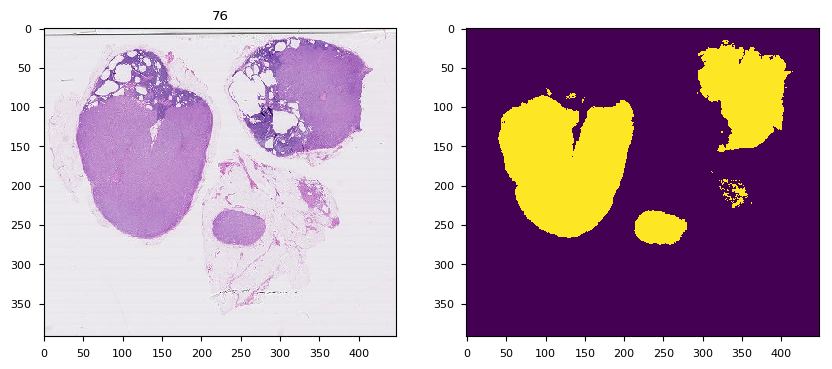

In [146]:
# note: slide 84,91 is not usable
# for slide_no in list(set(range(1,112))- set([84,91])):
for slide_no in [76]:

    slide_no_str = '{:03}'.format(slide_no)
    slide_path = DATASET_DIR+"/training/tumor/tumor_"+slide_no_str+".tif"
    tumor_mask_path = DATASET_DIR+"/training/tumor/mask/tumor_"+slide_no_str+"_mask.tif"

    slide = open_slide(slide_path)

    tumor_mask_slide = open_slide(tumor_mask_path)

    # See https://openslide.org/api/python/#openslide.OpenSlide.read_region
    # Note: x,y coords are with respect to level 0.
    # There is an example below of working with coordinates
    # with respect to a higher zoom level.

#     print(tumor_mask_slide.level_count)
    assert(tumor_mask_slide.level_count >= 9)
    for k in range(tumor_mask_slide.level_count):
        assert(
            tumor_mask_slide.level_dimensions[k] == slide.level_dimensions[k])

    # Example: read the entire mask at the same zoom level
    tumor_mask_image = read_slide(tumor_mask_slide,
                                  x=0,
                                  y=0,
                                  level=8,
                                  width=tumor_mask_slide.level_dimensions[8][0],
                                  height=tumor_mask_slide.level_dimensions[8][1])

    # Note: the program provided by the dataset authors generates a mask with R,G,B channels.
    # The mask info we need is in the first channel only.
    # If you skip this step, the mask will be displayed as all black.
    tumor_mask_image = tumor_mask_image[:, :, 0]


#     level = 8
    slide_image = read_slide(slide,
                             x=0,
                             y=0,
                             level=8,
                             width=slide.level_dimensions[8][0],
                             height=slide.level_dimensions[8][1])

    fig, ax = plt.subplots(1, 2, figsize=(10, 5), dpi=100)

    ax[0].imshow(slide_image)
    ax[0].set_title(slide_no)

    ax[1].imshow(tumor_mask_image)
    plt.gca().grid(False)
#     np.unique(tumor_mask_image)

    print("Read WSI from %s with width: %d, height: %d" %
          (slide_path, slide.level_dimensions[0][0], slide.level_dimensions[0][1]))
    print("Read tumor mask from %s" % (tumor_mask_path))

    print("Slide includes %d levels" % (len(slide.level_dimensions)))
    print("Mask includes %d levels" % len(tumor_mask_slide.level_dimensions))
    print("downsamples:", slide.level_downsamples)
    for i in range(8):
        print(slide.level_dimensions[i], tumor_mask_slide.level_dimensions[i])

In [147]:
base_level = 1  # the smallest level where we look at the image
tissue_mask_level = base_level + 7  # the level where we decide if there is tissue
zoom = 2**base_level

# define a window for sliding through the entire slide
context_size = 256
center_size = 128
margin_size = (context_size - center_size)//2

margin_size_1 = (context_size*2 - center_size)//2

0.008017492711370262
0.04103840196793003


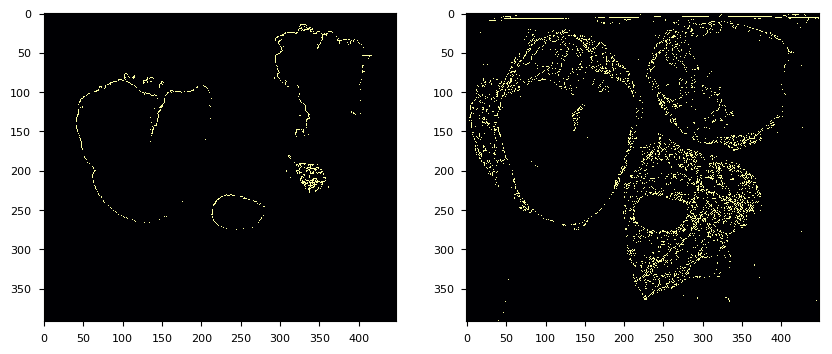

In [148]:
# demonstrating the edge effect:
# if we use the final zoom level as the tissue mask or tumor mask,
# we will miss some edges because the hihger level is mean-pooling of
# its lower level. To make sure we don't miss small tumor, we get the mask
# from lower layer and use a min-pooling.
t1 = get_tumor_mask(tumor_mask_slide, base_level, 4)
t2 = get_tumor_mask(tumor_mask_slide, base_level, 7)
print(np.sum(t1 != t2)/(t1.shape[0]*t1.shape[1]))
plt.figure(figsize=(10, 10), dpi=100)
plt.subplot(1, 2, 1)
plt.imshow(t1 != t2, cmap='inferno', vmin=0, vmax=1)
plt.grid(False)
t1 = get_tissue_mask(slide, base_level, 6)
t2 = get_tissue_mask(slide, base_level, 7)
print(np.sum(t1 != t2)/(t1.shape[0]*t1.shape[1]))
# plt.figure(figsize=(10,10), dpi=100)
plt.subplot(1, 2, 2)
plt.imshow(t1 != t2, cmap='inferno', vmin=0, vmax=1)
plt.grid(False)

In [157]:
slide_image = get_slide_image(slide, tissue_mask_level)
tissue_mask = get_tissue_mask(slide, base_level, level_up=3)
tumor_mask = get_tumor_mask(tumor_mask_slide, base_level, level_up=3)
normal_mask = np.logical_and(
    tissue_mask, ~tumor_mask)  # mask for normal tissue
combined_mask = np.logical_or(tissue_mask, tumor_mask_image)

83392 tissue_pixels pixels (47.5% of the image)


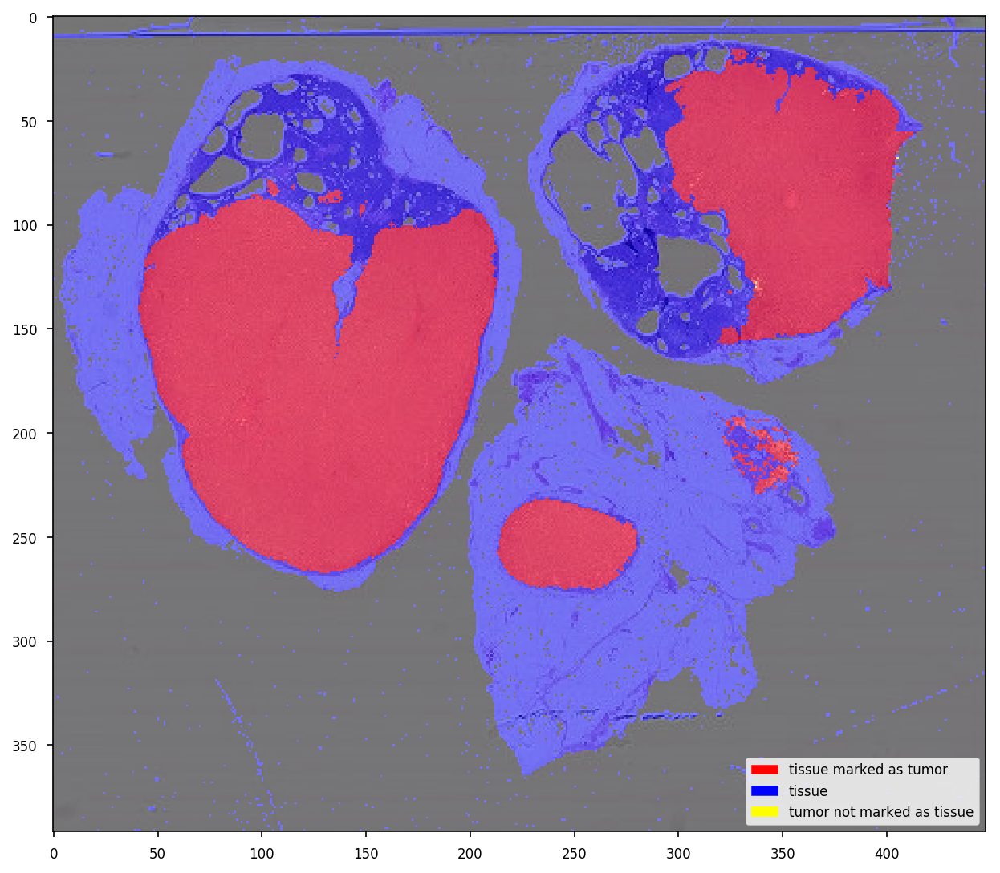

In [158]:
visualize_slide(slide_image, tissue_mask, tumor_mask_image, dpi=150)
len_tissue_pixels = combined_mask.sum()
percent_tissue = len_tissue_pixels / \
    (combined_mask.shape[0] * combined_mask.shape[1]) * 100
print("%d tissue_pixels pixels (%.1f%% of the image)" %
      (len_tissue_pixels, percent_tissue))

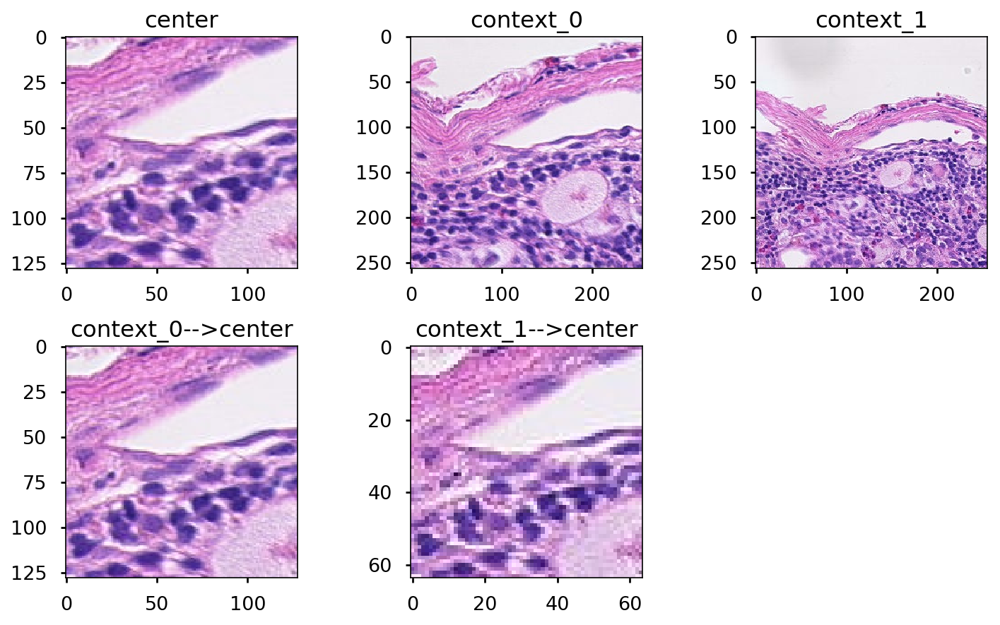

In [13]:
# dir(slide)
k = 1001
yy, xx = np.where(combined_mask)
id_x = xx[k]
id_y = yy[k]

context_image_0 = read_slide(slide,
                             x=(id_x*center_size - margin_size)*zoom,
                             y=(id_y*center_size - margin_size)*zoom,
                             level=base_level,
                             width=context_size,
                             height=context_size)

context_image_1 = read_slide(slide,
                             x=(id_x*center_size - margin_size_1)*zoom,
                             y=(id_y*center_size - margin_size_1)*zoom,
                             level=base_level+1,
                             width=context_size,
                             height=context_size)

center_image = read_slide(slide,
                          x=id_x*center_size*zoom,
                          y=id_y*center_size*zoom,
                          level=base_level,
                          width=center_size,
                          height=center_size)


fig, ax = plt.subplots(2, 3, figsize=(10, 6), dpi=150)
ax = ax.flatten()


ax[0].set_title('center')
ax[0].imshow(center_image)

ax[1].set_title('context_0')
ax[1].imshow(context_image_0)

ax[2].set_title('context_1')
ax[2].imshow(context_image_1)

ax[3].set_title('context_0-->center')
ax[3].imshow(context_image_0[margin_size:-
                             margin_size:1, margin_size:-margin_size:1])

ax[4].set_title('context_1-->center')
ax[4].imshow(context_image_1[margin_size_1//2:-margin_size_1 //
                             2:1, margin_size_1//2:-margin_size_1//2:1])


fig.delaxes(ax[5])

plt.tight_layout()

In [14]:
# # example for saving the patch image
# patch_exp = read_slide_raw(slide, (id_x*center_size - margin_size)*zoom,
#                            (id_y*center_size - margin_size)*zoom, base_level, 256, 256)
# np.save('example',np.asarray(patch_exp))
# patch_exp.save('./example.png',compress_level=0)
# img = np.asarray(Image.open("example.png"))
# imgplot = plt.imshow(img)
# img_np = np.asarray(img)
# np.alltrue(img_np==context_image_0)

# 1.2. parsing slides into patches

In [14]:
# create directories to store the patches. you can change it to somewhere else
# but you need to make sure you have sufficienet spaces, estimated will take 200 Gb
NORMAL_PATCH_DIR = DATASET_DIR + '/patch256/normal/'
TUMOR_PATCH_DIR = DATASET_DIR + '/patch256/tumor/'


def make_directory_if_not_exist(directory):
    if not os.path.exists(directory):
        os.makedirs(directory)


make_directory_if_not_exist(NORMAL_PATCH_DIR)
make_directory_if_not_exist(TUMOR_PATCH_DIR)

# print(NORMAL_PATCH_DIR)
# print(TUMOR_PATCH_DIR)

/media/boxi/V2/CAMELYON16/patch256/normal/
/media/boxi/V2/CAMELYON16/patch256/tumor/


In [9]:
from joblib import Parallel, delayed


def allocate_patch(is_tumor_slide, slide_no, id_x, id_y, has_tumor):
    """
    Save a patch of a training slide into disk
    Input:
        is_tumor_slide (bool): whether the slide contains tumor
        slide_no (int): the slide number in the training dataset
        id_x (int): x index of the left most position at base_level
        id_y (int): y index of the top most position at base_level
        has_tumor (bool): whether this patch contains tumor cells
    """

    slide_no_str = '{:03}'.format(slide_no)
    if is_tumor_slide:
        slide_path = DATASET_DIR+"/training/tumor/tumor_"+slide_no_str+".tif"
    else:
        slide_path = DATASET_DIR+"/training/normal/normal_"+slide_no_str+".tif"

    slide = open_slide(slide_path)
    context_image_0 = read_slide_raw(slide,
                                     x=(id_x*center_size - margin_size)*zoom,
                                     y=(id_y*center_size - margin_size)*zoom,
                                     level=base_level,
                                     width=context_size,
                                     height=context_size)
    if has_tumor:
        save_loc = TUMOR_PATCH_DIR + \
            '{0}_{1}_{2}_{3}.png'.format(is_tumor_slide, slide_no, id_x, id_y)
    else:
        save_loc = NORMAL_PATCH_DIR + \
            '{0}_{1}_{2}_{3}.png'.format(is_tumor_slide, slide_no, id_x, id_y)

    context_image_0.save(save_loc, compress_level=0)
    return 0


# has_tumor = int(1)
# out = Parallel(n_jobs=64, verbose=10)(delayed(allocate_patch)(
#     is_tumor_slide, slide_no, id_x, id_y, has_tumor)
#     for id_y, id_x in zip(*np.where(tumor_mask)))

# has_tumor = int(0)
# out = Parallel(n_jobs=64, verbose=10)(delayed(allocate_patch)(
#     is_tumor_slide, slide_no, id_x, id_y, has_tumor)
#     for id_y, id_x in zip(*np.where(normal_mask)))

In [10]:
# reading normal patches from all slides in tumor folder
is_tumor_slide = int(1)
for slide_no in list(set(range(1, 112)) - set([84, 91])):
    print('reading slide_no =', slide_no)

    slide_no_str = '{:03}'.format(slide_no)
    slide_path = DATASET_DIR+"/training/tumor/tumor_"+slide_no_str+".tif"
    tumor_mask_path = DATASET_DIR+"/training/tumor/mask/tumor_"+slide_no_str+"_mask.tif"

    slide = open_slide(slide_path)
    tumor_mask_slide = open_slide(tumor_mask_path)

    assert(tumor_mask_slide.level_count >= 9)
    for k in range(tumor_mask_slide.level_count):
        assert(
            tumor_mask_slide.level_dimensions[k] == slide.level_dimensions[k])

    tissue_mask = get_tissue_mask(slide, base_level, level_up=3)
    tumor_mask = get_tumor_mask(tumor_mask_slide, base_level, level_up=3)
    normal_mask = np.logical_and(tissue_mask, ~tumor_mask)

    ids = np.where(normal_mask)
    selected_idx = np.random.choice(
        np.arange(normal_mask.sum()), 5800, replace=False)

    has_tumor = 0
    out = Parallel(n_jobs=64, verbose=5)(delayed(allocate_patch)(
        is_tumor_slide, slide_no, id_x, id_y, has_tumor)
        for id_y, id_x in zip(ids[0][selected_idx], ids[1][selected_idx]))

reading slide_no = 1


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    1.8s
[Parallel(n_jobs=64)]: Done 160 tasks      | elapsed:    2.5s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:    3.4s
[Parallel(n_jobs=64)]: Done 520 tasks      | elapsed:    4.5s
[Parallel(n_jobs=64)]: Done 754 tasks      | elapsed:    5.7s
[Parallel(n_jobs=64)]: Done 1024 tasks      | elapsed:    7.1s
[Parallel(n_jobs=64)]: Done 1330 tasks      | elapsed:    8.6s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:   10.1s
[Parallel(n_jobs=64)]: Done 2050 tasks      | elapsed:   11.8s
[Parallel(n_jobs=64)]: Done 2464 tasks      | elapsed:   13.6s
[Parallel(n_jobs=64)]: Done 2914 tasks      | elapsed:   15.6s
[Parallel(n_jobs=64)]: Done 3400 tasks      | elapsed:   17.7s
[Parallel(n_jobs=64)]: Done 3922 tasks      | elapsed:   19.8s
[Parallel(n_jobs=64)]: Done 4480 tasks      | elapsed:   22.1s
[Parallel(n_jobs=64)]: Done 5074 tasks      | 

reading slide_no = 2


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.0s
[Parallel(n_jobs=64)]: Done 1298 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 1766 tasks      | elapsed:    8.5s
[Parallel(n_jobs=64)]: Done 2306 tasks      | elapsed:   10.9s
[Parallel(n_jobs=64)]: Done 2918 tasks      | elapsed:   13.3s
[Parallel(n_jobs=64)]: Done 3602 tasks      | elapsed:   16.3s
[Parallel(n_jobs=64)]: Done 4358 tasks      | elapsed:   19.4s
[Parallel(n_jobs=64)]: Done 5186 tasks      | elapsed:   22.7s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   25.0s finished


reading slide_no = 3


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    4.8s
[Parallel(n_jobs=64)]: Done 1300 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 1768 tasks      | elapsed:    8.5s
[Parallel(n_jobs=64)]: Done 2308 tasks      | elapsed:   11.1s
[Parallel(n_jobs=64)]: Done 2920 tasks      | elapsed:   13.5s
[Parallel(n_jobs=64)]: Done 3604 tasks      | elapsed:   16.5s
[Parallel(n_jobs=64)]: Done 4360 tasks      | elapsed:   19.7s
[Parallel(n_jobs=64)]: Done 5188 tasks      | elapsed:   23.1s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   25.2s finished


reading slide_no = 4


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    3.6s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    8.3s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:   10.1s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:   11.9s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:   14.3s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   16.9s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   20.1s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   23.4s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   26.5s finished


reading slide_no = 5


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    4.9s
[Parallel(n_jobs=64)]: Done 1298 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1766 tasks      | elapsed:    8.4s
[Parallel(n_jobs=64)]: Done 2306 tasks      | elapsed:   10.8s
[Parallel(n_jobs=64)]: Done 2918 tasks      | elapsed:   13.3s
[Parallel(n_jobs=64)]: Done 3602 tasks      | elapsed:   16.1s
[Parallel(n_jobs=64)]: Done 4358 tasks      | elapsed:   19.2s
[Parallel(n_jobs=64)]: Done 5186 tasks      | elapsed:   23.0s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   25.3s finished


reading slide_no = 6


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.4s
[Parallel(n_jobs=64)]: Done 1226 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 1460 tasks      | elapsed:    7.8s
[Parallel(n_jobs=64)]: Done 1730 tasks      | elapsed:    9.1s
[Parallel(n_jobs=64)]: Done 2036 tasks      | elapsed:   10.4s
[Parallel(n_jobs=64)]: Done 2378 tasks      | elapsed:   12.0s
[Parallel(n_jobs=64)]: Done 2756 tasks      | elapsed:   13.9s
[Parallel(n_jobs=64)]: Done 3170 tasks      | elapsed:   15.7s
[Parallel(n_jobs=64)]: Done 3620 tasks      | elapsed:   17.7s
[Parallel(n_jobs=64)]: Done 4106 tasks      | elapsed:   19.9s
[Parallel(n_jobs=64)]: Done 4628 tasks      | elapsed:   22.3s
[Parallel(n_jobs=64)]: Done 5186 tasks      | elapsed:   24.8s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 7


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.3s
[Parallel(n_jobs=64)]: Done 1298 tasks      | elapsed:    7.2s
[Parallel(n_jobs=64)]: Done 1766 tasks      | elapsed:    8.9s
[Parallel(n_jobs=64)]: Done 2306 tasks      | elapsed:   11.6s
[Parallel(n_jobs=64)]: Done 2918 tasks      | elapsed:   14.3s
[Parallel(n_jobs=64)]: Done 3602 tasks      | elapsed:   17.7s
[Parallel(n_jobs=64)]: Done 4358 tasks      | elapsed:   21.2s
[Parallel(n_jobs=64)]: Done 5186 tasks      | elapsed:   24.9s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   27.3s finished


reading slide_no = 8


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.9s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.4s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.4s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.6s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    9.8s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.3s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   12.8s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   14.5s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   16.5s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   18.6s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   20.8s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   23.1s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   25.8s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 9


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.2s
[Parallel(n_jobs=64)]: Done 1226 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1460 tasks      | elapsed:    7.7s
[Parallel(n_jobs=64)]: Done 1730 tasks      | elapsed:    8.9s
[Parallel(n_jobs=64)]: Done 2036 tasks      | elapsed:   10.4s
[Parallel(n_jobs=64)]: Done 2378 tasks      | elapsed:   12.0s
[Parallel(n_jobs=64)]: Done 2756 tasks      | elapsed:   13.8s
[Parallel(n_jobs=64)]: Done 3170 tasks      | elapsed:   15.7s
[Parallel(n_jobs=64)]: Done 3620 tasks      | elapsed:   17.8s
[Parallel(n_jobs=64)]: Done 4106 tasks      | elapsed:   20.0s
[Parallel(n_jobs=64)]: Done 4628 tasks      | elapsed:   22.3s
[Parallel(n_jobs=64)]: Done 5186 tasks      | elapsed:   24.8s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 10


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.6s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.2s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.1s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.2s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    9.4s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   10.8s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   12.3s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   14.0s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   15.9s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   17.9s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   20.1s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   22.2s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   25.0s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 11


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.1s
[Parallel(n_jobs=64)]: Done 1298 tasks      | elapsed:    7.1s
[Parallel(n_jobs=64)]: Done 1766 tasks      | elapsed:    9.1s
[Parallel(n_jobs=64)]: Done 2306 tasks      | elapsed:   11.3s
[Parallel(n_jobs=64)]: Done 2918 tasks      | elapsed:   13.7s
[Parallel(n_jobs=64)]: Done 3602 tasks      | elapsed:   17.0s
[Parallel(n_jobs=64)]: Done 4358 tasks      | elapsed:   20.4s
[Parallel(n_jobs=64)]: Done 5186 tasks      | elapsed:   24.2s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   26.5s finished


reading slide_no = 12


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.8s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.4s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    9.7s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.1s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   12.7s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   14.5s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   16.5s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   18.3s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   20.6s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   23.1s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   25.6s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 13


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    4.8s
[Parallel(n_jobs=64)]: Done 1300 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 1768 tasks      | elapsed:    8.7s
[Parallel(n_jobs=64)]: Done 2308 tasks      | elapsed:   11.4s
[Parallel(n_jobs=64)]: Done 2920 tasks      | elapsed:   14.3s
[Parallel(n_jobs=64)]: Done 3604 tasks      | elapsed:   17.7s
[Parallel(n_jobs=64)]: Done 4360 tasks      | elapsed:   21.2s
[Parallel(n_jobs=64)]: Done 5188 tasks      | elapsed:   24.7s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   27.2s finished


reading slide_no = 14


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.4s
[Parallel(n_jobs=64)]: Done 1224 tasks      | elapsed:    6.8s
[Parallel(n_jobs=64)]: Done 1458 tasks      | elapsed:    7.9s
[Parallel(n_jobs=64)]: Done 1728 tasks      | elapsed:    9.1s
[Parallel(n_jobs=64)]: Done 2034 tasks      | elapsed:   10.6s
[Parallel(n_jobs=64)]: Done 2376 tasks      | elapsed:   12.1s
[Parallel(n_jobs=64)]: Done 2754 tasks      | elapsed:   13.9s
[Parallel(n_jobs=64)]: Done 3168 tasks      | elapsed:   15.9s
[Parallel(n_jobs=64)]: Done 3618 tasks      | elapsed:   18.1s
[Parallel(n_jobs=64)]: Done 4104 tasks      | elapsed:   20.3s
[Parallel(n_jobs=64)]: Done 4626 tasks      | elapsed:   22.8s
[Parallel(n_jobs=64)]: Done 5184 tasks      | elapsed:   25.6s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 15


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.7s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.2s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.1s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.1s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    9.2s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   10.5s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   12.0s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   13.9s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   15.9s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   17.9s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   20.3s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   22.9s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   25.5s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 16


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    4.9s
[Parallel(n_jobs=64)]: Done 1300 tasks      | elapsed:    6.9s
[Parallel(n_jobs=64)]: Done 1768 tasks      | elapsed:    8.9s
[Parallel(n_jobs=64)]: Done 2308 tasks      | elapsed:   11.7s
[Parallel(n_jobs=64)]: Done 2920 tasks      | elapsed:   14.4s
[Parallel(n_jobs=64)]: Done 3604 tasks      | elapsed:   17.8s
[Parallel(n_jobs=64)]: Done 4360 tasks      | elapsed:   21.4s
[Parallel(n_jobs=64)]: Done 5188 tasks      | elapsed:   25.3s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   27.8s finished


reading slide_no = 17


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.4s
[Parallel(n_jobs=64)]: Done 1224 tasks      | elapsed:    6.8s
[Parallel(n_jobs=64)]: Done 1458 tasks      | elapsed:    7.9s
[Parallel(n_jobs=64)]: Done 1728 tasks      | elapsed:    9.3s
[Parallel(n_jobs=64)]: Done 2034 tasks      | elapsed:   10.8s
[Parallel(n_jobs=64)]: Done 2376 tasks      | elapsed:   12.4s
[Parallel(n_jobs=64)]: Done 2754 tasks      | elapsed:   14.1s
[Parallel(n_jobs=64)]: Done 3168 tasks      | elapsed:   16.2s
[Parallel(n_jobs=64)]: Done 3618 tasks      | elapsed:   18.3s
[Parallel(n_jobs=64)]: Done 4104 tasks      | elapsed:   20.5s
[Parallel(n_jobs=64)]: Done 4626 tasks      | elapsed:   23.0s
[Parallel(n_jobs=64)]: Done 5184 tasks      | elapsed:   25.5s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 18


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    4.7s
[Parallel(n_jobs=64)]: Done 1302 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 1770 tasks      | elapsed:    8.5s
[Parallel(n_jobs=64)]: Done 2310 tasks      | elapsed:   11.4s
[Parallel(n_jobs=64)]: Done 2922 tasks      | elapsed:   14.2s
[Parallel(n_jobs=64)]: Done 3606 tasks      | elapsed:   17.3s
[Parallel(n_jobs=64)]: Done 4362 tasks      | elapsed:   20.6s
[Parallel(n_jobs=64)]: Done 5190 tasks      | elapsed:   24.5s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   26.9s finished


reading slide_no = 19


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.0s
[Parallel(n_jobs=64)]: Done 1300 tasks      | elapsed:    6.9s
[Parallel(n_jobs=64)]: Done 1768 tasks      | elapsed:    9.0s
[Parallel(n_jobs=64)]: Done 2308 tasks      | elapsed:   11.6s
[Parallel(n_jobs=64)]: Done 2920 tasks      | elapsed:   14.4s
[Parallel(n_jobs=64)]: Done 3604 tasks      | elapsed:   17.6s
[Parallel(n_jobs=64)]: Done 4360 tasks      | elapsed:   21.2s
[Parallel(n_jobs=64)]: Done 5188 tasks      | elapsed:   25.1s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   27.5s finished


reading slide_no = 20


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    3.4s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    8.0s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:   10.0s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:   12.2s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:   14.6s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   17.8s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   21.3s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   24.5s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   28.2s finished


reading slide_no = 21


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.4s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.8s
[Parallel(n_jobs=64)]: Done 1224 tasks      | elapsed:    7.4s
[Parallel(n_jobs=64)]: Done 1458 tasks      | elapsed:    8.4s
[Parallel(n_jobs=64)]: Done 1728 tasks      | elapsed:    9.8s
[Parallel(n_jobs=64)]: Done 2034 tasks      | elapsed:   11.4s
[Parallel(n_jobs=64)]: Done 2376 tasks      | elapsed:   13.1s
[Parallel(n_jobs=64)]: Done 2754 tasks      | elapsed:   14.8s
[Parallel(n_jobs=64)]: Done 3168 tasks      | elapsed:   16.8s
[Parallel(n_jobs=64)]: Done 3618 tasks      | elapsed:   18.8s
[Parallel(n_jobs=64)]: Done 4104 tasks      | elapsed:   21.2s
[Parallel(n_jobs=64)]: Done 4626 tasks      | elapsed:   23.6s
[Parallel(n_jobs=64)]: Done 5184 tasks      | elapsed:   26.1s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 22


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.0s
[Parallel(n_jobs=64)]: Done 1250 tasks      | elapsed:    6.4s
[Parallel(n_jobs=64)]: Done 1484 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 1754 tasks      | elapsed:    8.9s
[Parallel(n_jobs=64)]: Done 2060 tasks      | elapsed:   10.5s
[Parallel(n_jobs=64)]: Done 2402 tasks      | elapsed:   12.2s
[Parallel(n_jobs=64)]: Done 2780 tasks      | elapsed:   14.1s
[Parallel(n_jobs=64)]: Done 3194 tasks      | elapsed:   16.1s
[Parallel(n_jobs=64)]: Done 3644 tasks      | elapsed:   18.3s
[Parallel(n_jobs=64)]: Done 4130 tasks      | elapsed:   20.6s
[Parallel(n_jobs=64)]: Done 4652 tasks      | elapsed:   23.1s
[Parallel(n_jobs=64)]: Done 5210 tasks      | elapsed:   25.7s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 23


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.9s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.4s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.4s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.5s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    9.8s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.2s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   12.9s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   14.6s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   16.7s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   18.7s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   21.0s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   23.7s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   26.2s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 24


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.4s
[Parallel(n_jobs=64)]: Done 772 tasks      | elapsed:    5.1s
[Parallel(n_jobs=64)]: Done 1032 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 1266 tasks      | elapsed:    7.4s
[Parallel(n_jobs=64)]: Done 1536 tasks      | elapsed:    8.8s
[Parallel(n_jobs=64)]: Done 1842 tasks      | elapsed:   10.3s
[Parallel(n_jobs=64)]: Done 2184 tasks      | elapsed:   12.0s
[Parallel(n_jobs=64)]: Done 2562 tasks      | elapsed:   13.5s
[Parallel(n_jobs=64)]: Done 2976 tasks      | elapsed:   15.3s
[Parallel(n_jobs=64)]: Done 3426 tasks      | elapsed:   17.7s
[Parallel(n_jobs=64)]: Done 3912 tasks      | elapsed:   20.1s
[Parallel(n_jobs=64)]: Done 4434 tasks      | elapsed:   22.6s
[Parallel(n_jobs=64)]: Done 4992 tasks      | elapsed:   25.3s
[Parallel(n_jobs=64)]: Done 5586 tasks      

reading slide_no = 25


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.3s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.5s
[Parallel(n_jobs=64)]: Done 1224 tasks      | elapsed:    6.9s
[Parallel(n_jobs=64)]: Done 1458 tasks      | elapsed:    8.1s
[Parallel(n_jobs=64)]: Done 1728 tasks      | elapsed:    9.4s
[Parallel(n_jobs=64)]: Done 2034 tasks      | elapsed:   10.9s
[Parallel(n_jobs=64)]: Done 2376 tasks      | elapsed:   12.7s
[Parallel(n_jobs=64)]: Done 2754 tasks      | elapsed:   14.5s
[Parallel(n_jobs=64)]: Done 3168 tasks      | elapsed:   16.7s
[Parallel(n_jobs=64)]: Done 3618 tasks      | elapsed:   18.9s
[Parallel(n_jobs=64)]: Done 4104 tasks      | elapsed:   21.3s
[Parallel(n_jobs=64)]: Done 4626 tasks      | elapsed:   23.8s
[Parallel(n_jobs=64)]: Done 5184 tasks      | elapsed:   26.5s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 26


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 192 tasks      | elapsed:    1.4s
[Parallel(n_jobs=64)]: Done 516 tasks      | elapsed:    3.3s
[Parallel(n_jobs=64)]: Done 912 tasks      | elapsed:    5.2s
[Parallel(n_jobs=64)]: Done 1380 tasks      | elapsed:    7.4s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.1s
[Parallel(n_jobs=64)]: Done 2532 tasks      | elapsed:   13.0s
[Parallel(n_jobs=64)]: Done 3216 tasks      | elapsed:   16.6s
[Parallel(n_jobs=64)]: Done 3972 tasks      | elapsed:   20.1s
[Parallel(n_jobs=64)]: Done 4800 tasks      | elapsed:   24.0s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   28.5s finished


reading slide_no = 27


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    3.0s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.8s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.9s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    9.2s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.5s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   12.0s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   13.6s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   15.6s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   17.6s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   19.7s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   22.0s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   24.5s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   27.1s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 28


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.9s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.7s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.8s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.1s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.7s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   13.3s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   15.3s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   17.3s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   19.5s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   21.9s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   24.4s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   26.9s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 29


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    3.1s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.9s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    8.0s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    9.2s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.6s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   12.1s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   13.5s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   15.3s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   17.3s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   19.4s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   21.5s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   23.9s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   26.6s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 30


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    3.8s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    9.0s
[Parallel(n_jobs=64)]: Done 1926 tasks      | elapsed:   10.8s
[Parallel(n_jobs=64)]: Done 2162 tasks      | elapsed:   12.0s
[Parallel(n_jobs=64)]: Done 2432 tasks      | elapsed:   13.3s
[Parallel(n_jobs=64)]: Done 2738 tasks      | elapsed:   14.8s
[Parallel(n_jobs=64)]: Done 3080 tasks      | elapsed:   16.4s
[Parallel(n_jobs=64)]: Done 3458 tasks      | elapsed:   18.3s
[Parallel(n_jobs=64)]: Done 3872 tasks      | elapsed:   20.4s
[Parallel(n_jobs=64)]: Done 4322 tasks      | elapsed:   22.6s
[Parallel(n_jobs=64)]: Done 4808 tasks      | elapsed:   24.9s
[Parallel(n_jobs=64)]: Done 5330 tasks      | elapsed:   27.4s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   29.5s finished


reading slide_no = 31


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.5s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    5.5s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    6.5s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    8.7s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:    9.9s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   11.3s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   12.9s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   14.5s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   16.3s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   18.2s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   20.3s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   22.6s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 32


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 192 tasks      | elapsed:    1.6s
[Parallel(n_jobs=64)]: Done 516 tasks      | elapsed:    3.6s
[Parallel(n_jobs=64)]: Done 912 tasks      | elapsed:    5.8s
[Parallel(n_jobs=64)]: Done 1380 tasks      | elapsed:    8.0s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.9s
[Parallel(n_jobs=64)]: Done 2532 tasks      | elapsed:   13.7s
[Parallel(n_jobs=64)]: Done 3216 tasks      | elapsed:   16.9s
[Parallel(n_jobs=64)]: Done 3972 tasks      | elapsed:   20.6s
[Parallel(n_jobs=64)]: Done 4800 tasks      | elapsed:   24.6s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   28.8s finished


reading slide_no = 33


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    3.4s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    8.1s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:   10.0s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:   11.8s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:   14.1s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   17.0s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   20.4s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   24.1s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   27.7s finished


reading slide_no = 34


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    3.5s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    8.2s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:    9.8s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:   11.9s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:   14.4s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   17.1s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   20.4s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   23.8s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   26.7s finished


reading slide_no = 35


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.7s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.2s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.2s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.3s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    9.5s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.0s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   12.7s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   14.5s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   16.5s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   18.5s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   20.8s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   23.2s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   25.8s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 36


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.9s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.7s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.1s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.6s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   13.4s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   15.1s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   17.1s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   19.3s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   21.6s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   24.1s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   26.8s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 37


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.1s
[Parallel(n_jobs=64)]: Done 1226 tasks      | elapsed:    6.4s
[Parallel(n_jobs=64)]: Done 1460 tasks      | elapsed:    7.5s
[Parallel(n_jobs=64)]: Done 1730 tasks      | elapsed:    8.9s
[Parallel(n_jobs=64)]: Done 2036 tasks      | elapsed:   10.4s
[Parallel(n_jobs=64)]: Done 2378 tasks      | elapsed:   12.2s
[Parallel(n_jobs=64)]: Done 2756 tasks      | elapsed:   14.1s
[Parallel(n_jobs=64)]: Done 3170 tasks      | elapsed:   16.0s
[Parallel(n_jobs=64)]: Done 3620 tasks      | elapsed:   18.2s
[Parallel(n_jobs=64)]: Done 4106 tasks      | elapsed:   20.5s
[Parallel(n_jobs=64)]: Done 4628 tasks      | elapsed:   23.0s
[Parallel(n_jobs=64)]: Done 5186 tasks      | elapsed:   25.4s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 38


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    4.5s
[Parallel(n_jobs=64)]: Done 1300 tasks      | elapsed:    6.1s
[Parallel(n_jobs=64)]: Done 1768 tasks      | elapsed:    8.0s
[Parallel(n_jobs=64)]: Done 2308 tasks      | elapsed:   10.3s
[Parallel(n_jobs=64)]: Done 2920 tasks      | elapsed:   12.6s
[Parallel(n_jobs=64)]: Done 3604 tasks      | elapsed:   15.3s
[Parallel(n_jobs=64)]: Done 4360 tasks      | elapsed:   18.2s
[Parallel(n_jobs=64)]: Done 5188 tasks      | elapsed:   21.4s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   23.6s finished


reading slide_no = 39


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.7s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.2s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.2s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.3s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    9.6s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.0s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   12.6s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   14.5s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   16.3s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   18.4s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   20.8s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   23.2s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   25.6s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 40


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.8s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.5s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.7s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.0s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.4s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   12.9s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   14.7s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   16.6s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   18.5s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   20.8s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   23.4s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   25.7s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 41


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:    0.5s
[Parallel(n_jobs=64)]: Done 665 tasks      | elapsed:    4.4s
[Parallel(n_jobs=64)]: Done 1187 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1781 tasks      | elapsed:    9.4s
[Parallel(n_jobs=64)]: Done 2483 tasks      | elapsed:   13.0s
[Parallel(n_jobs=64)]: Done 3293 tasks      | elapsed:   16.7s
[Parallel(n_jobs=64)]: Done 4211 tasks      | elapsed:   20.7s
[Parallel(n_jobs=64)]: Done 5237 tasks      | elapsed:   25.0s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   27.4s finished


reading slide_no = 42


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    3.0s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.8s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.8s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.2s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.6s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   13.3s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   15.1s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   16.8s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   18.9s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   21.2s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   23.7s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   26.2s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 43


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.1s
[Parallel(n_jobs=64)]: Done 1298 tasks      | elapsed:    7.0s
[Parallel(n_jobs=64)]: Done 1766 tasks      | elapsed:    9.0s
[Parallel(n_jobs=64)]: Done 2306 tasks      | elapsed:   11.7s
[Parallel(n_jobs=64)]: Done 2918 tasks      | elapsed:   14.5s
[Parallel(n_jobs=64)]: Done 3602 tasks      | elapsed:   17.9s
[Parallel(n_jobs=64)]: Done 4358 tasks      | elapsed:   21.4s
[Parallel(n_jobs=64)]: Done 5186 tasks      | elapsed:   25.1s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   27.6s finished


reading slide_no = 44


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    3.6s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    8.4s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:   10.3s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:   12.4s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:   14.7s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   17.7s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   21.0s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   24.5s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   28.0s finished


reading slide_no = 45


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.2s
[Parallel(n_jobs=64)]: Done 1228 tasks      | elapsed:    6.5s
[Parallel(n_jobs=64)]: Done 1462 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 1732 tasks      | elapsed:    8.9s
[Parallel(n_jobs=64)]: Done 2038 tasks      | elapsed:   10.3s
[Parallel(n_jobs=64)]: Done 2380 tasks      | elapsed:   11.9s
[Parallel(n_jobs=64)]: Done 2758 tasks      | elapsed:   13.5s
[Parallel(n_jobs=64)]: Done 3172 tasks      | elapsed:   15.4s
[Parallel(n_jobs=64)]: Done 3622 tasks      | elapsed:   17.4s
[Parallel(n_jobs=64)]: Done 4108 tasks      | elapsed:   19.3s
[Parallel(n_jobs=64)]: Done 4630 tasks      | elapsed:   21.3s
[Parallel(n_jobs=64)]: Done 5188 tasks      | elapsed:   23.7s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 46


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.4s
[Parallel(n_jobs=64)]: Done 772 tasks      | elapsed:    5.0s
[Parallel(n_jobs=64)]: Done 1032 tasks      | elapsed:    6.2s
[Parallel(n_jobs=64)]: Done 1266 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 1536 tasks      | elapsed:    8.7s
[Parallel(n_jobs=64)]: Done 1842 tasks      | elapsed:   10.2s
[Parallel(n_jobs=64)]: Done 2184 tasks      | elapsed:   11.9s
[Parallel(n_jobs=64)]: Done 2562 tasks      | elapsed:   13.7s
[Parallel(n_jobs=64)]: Done 2976 tasks      | elapsed:   15.9s
[Parallel(n_jobs=64)]: Done 3426 tasks      | elapsed:   17.9s
[Parallel(n_jobs=64)]: Done 3912 tasks      | elapsed:   20.2s
[Parallel(n_jobs=64)]: Done 4434 tasks      | elapsed:   22.3s
[Parallel(n_jobs=64)]: Done 4992 tasks      | elapsed:   24.5s
[Parallel(n_jobs=64)]: Done 5586 tasks      

reading slide_no = 47


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    3.1s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    7.1s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    8.1s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    9.2s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.6s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   12.1s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   13.8s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   15.4s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   17.4s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   19.5s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   21.9s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   24.4s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   27.0s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 48


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    4.9s
[Parallel(n_jobs=64)]: Done 1300 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1768 tasks      | elapsed:    8.4s
[Parallel(n_jobs=64)]: Done 2308 tasks      | elapsed:   10.8s
[Parallel(n_jobs=64)]: Done 2920 tasks      | elapsed:   13.1s
[Parallel(n_jobs=64)]: Done 3604 tasks      | elapsed:   16.1s
[Parallel(n_jobs=64)]: Done 4360 tasks      | elapsed:   19.2s
[Parallel(n_jobs=64)]: Done 5188 tasks      | elapsed:   22.5s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   24.8s finished


reading slide_no = 49


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.9s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.5s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    9.7s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.1s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   12.5s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   14.1s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   16.1s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   18.3s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   20.8s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   23.4s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   26.0s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 50


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.3s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.4s
[Parallel(n_jobs=64)]: Done 1224 tasks      | elapsed:    6.5s
[Parallel(n_jobs=64)]: Done 1458 tasks      | elapsed:    7.5s
[Parallel(n_jobs=64)]: Done 1728 tasks      | elapsed:    8.6s
[Parallel(n_jobs=64)]: Done 2034 tasks      | elapsed:    9.9s
[Parallel(n_jobs=64)]: Done 2376 tasks      | elapsed:   11.6s
[Parallel(n_jobs=64)]: Done 2754 tasks      | elapsed:   13.5s
[Parallel(n_jobs=64)]: Done 3168 tasks      | elapsed:   15.4s
[Parallel(n_jobs=64)]: Done 3618 tasks      | elapsed:   17.3s
[Parallel(n_jobs=64)]: Done 4104 tasks      | elapsed:   19.6s
[Parallel(n_jobs=64)]: Done 4626 tasks      | elapsed:   22.1s
[Parallel(n_jobs=64)]: Done 5184 tasks      | elapsed:   24.4s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 51


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.9s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.7s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.9s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.3s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.7s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   13.5s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   15.3s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   17.4s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   19.6s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   22.0s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   24.4s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   26.9s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 52


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    3.6s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    8.7s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:   10.7s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:   12.6s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:   15.2s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   18.2s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   21.6s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   25.0s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   28.6s finished


reading slide_no = 53


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    3.0s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.8s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.9s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.2s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.7s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   13.3s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   15.1s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   16.8s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   18.9s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   21.2s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   23.7s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   26.4s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 54


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.3s
[Parallel(n_jobs=64)]: Done 1226 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1460 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 1730 tasks      | elapsed:    9.0s
[Parallel(n_jobs=64)]: Done 2036 tasks      | elapsed:   10.4s
[Parallel(n_jobs=64)]: Done 2378 tasks      | elapsed:   11.8s
[Parallel(n_jobs=64)]: Done 2756 tasks      | elapsed:   13.6s
[Parallel(n_jobs=64)]: Done 3170 tasks      | elapsed:   15.4s
[Parallel(n_jobs=64)]: Done 3620 tasks      | elapsed:   17.5s
[Parallel(n_jobs=64)]: Done 4106 tasks      | elapsed:   19.9s
[Parallel(n_jobs=64)]: Done 4628 tasks      | elapsed:   22.4s
[Parallel(n_jobs=64)]: Done 5186 tasks      | elapsed:   25.0s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 55


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.3s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.4s
[Parallel(n_jobs=64)]: Done 1296 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 1764 tasks      | elapsed:    9.4s
[Parallel(n_jobs=64)]: Done 2304 tasks      | elapsed:   12.0s
[Parallel(n_jobs=64)]: Done 2916 tasks      | elapsed:   14.9s
[Parallel(n_jobs=64)]: Done 3600 tasks      | elapsed:   18.1s
[Parallel(n_jobs=64)]: Done 4356 tasks      | elapsed:   21.6s
[Parallel(n_jobs=64)]: Done 5184 tasks      | elapsed:   25.6s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   28.0s finished


reading slide_no = 56


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.3s
[Parallel(n_jobs=64)]: Done 1296 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 1764 tasks      | elapsed:    9.4s
[Parallel(n_jobs=64)]: Done 2304 tasks      | elapsed:   11.9s
[Parallel(n_jobs=64)]: Done 2916 tasks      | elapsed:   15.0s
[Parallel(n_jobs=64)]: Done 3600 tasks      | elapsed:   18.4s
[Parallel(n_jobs=64)]: Done 4356 tasks      | elapsed:   21.8s
[Parallel(n_jobs=64)]: Done 5184 tasks      | elapsed:   25.7s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   28.3s finished


reading slide_no = 57


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.2s
[Parallel(n_jobs=64)]: Done 1296 tasks      | elapsed:    7.0s
[Parallel(n_jobs=64)]: Done 1764 tasks      | elapsed:    9.0s
[Parallel(n_jobs=64)]: Done 2304 tasks      | elapsed:   11.3s
[Parallel(n_jobs=64)]: Done 2916 tasks      | elapsed:   14.3s
[Parallel(n_jobs=64)]: Done 3600 tasks      | elapsed:   17.7s
[Parallel(n_jobs=64)]: Done 4356 tasks      | elapsed:   20.7s
[Parallel(n_jobs=64)]: Done 5184 tasks      | elapsed:   24.5s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   27.1s finished


reading slide_no = 58


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.1s
[Parallel(n_jobs=64)]: Done 1298 tasks      | elapsed:    7.0s
[Parallel(n_jobs=64)]: Done 1766 tasks      | elapsed:    9.0s
[Parallel(n_jobs=64)]: Done 2306 tasks      | elapsed:   11.7s
[Parallel(n_jobs=64)]: Done 2918 tasks      | elapsed:   14.4s
[Parallel(n_jobs=64)]: Done 3602 tasks      | elapsed:   17.7s
[Parallel(n_jobs=64)]: Done 4358 tasks      | elapsed:   21.2s
[Parallel(n_jobs=64)]: Done 5186 tasks      | elapsed:   25.0s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   27.7s finished


reading slide_no = 59


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.9s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.4s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.5s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    9.7s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.2s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   12.7s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   14.6s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   16.5s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   18.6s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   21.0s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   23.5s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   26.1s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 60


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.3s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.4s
[Parallel(n_jobs=64)]: Done 1224 tasks      | elapsed:    6.8s
[Parallel(n_jobs=64)]: Done 1458 tasks      | elapsed:    8.0s
[Parallel(n_jobs=64)]: Done 1728 tasks      | elapsed:    9.3s
[Parallel(n_jobs=64)]: Done 2034 tasks      | elapsed:   10.7s
[Parallel(n_jobs=64)]: Done 2376 tasks      | elapsed:   12.2s
[Parallel(n_jobs=64)]: Done 2754 tasks      | elapsed:   13.8s
[Parallel(n_jobs=64)]: Done 3168 tasks      | elapsed:   15.8s
[Parallel(n_jobs=64)]: Done 3618 tasks      | elapsed:   18.0s
[Parallel(n_jobs=64)]: Done 4104 tasks      | elapsed:   20.3s
[Parallel(n_jobs=64)]: Done 4626 tasks      | elapsed:   22.8s
[Parallel(n_jobs=64)]: Done 5184 tasks      | elapsed:   25.5s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 61


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    3.0s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    7.0s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    8.0s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    9.2s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.6s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   12.1s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   13.8s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   15.6s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   17.6s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   19.6s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   22.0s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   24.5s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   27.1s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 62


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 192 tasks      | elapsed:    1.6s
[Parallel(n_jobs=64)]: Done 516 tasks      | elapsed:    3.6s
[Parallel(n_jobs=64)]: Done 912 tasks      | elapsed:    5.7s
[Parallel(n_jobs=64)]: Done 1380 tasks      | elapsed:    7.9s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.6s
[Parallel(n_jobs=64)]: Done 2532 tasks      | elapsed:   13.5s
[Parallel(n_jobs=64)]: Done 3216 tasks      | elapsed:   16.8s
[Parallel(n_jobs=64)]: Done 3972 tasks      | elapsed:   20.5s
[Parallel(n_jobs=64)]: Done 4800 tasks      | elapsed:   24.2s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   28.7s finished


reading slide_no = 63


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.4s
[Parallel(n_jobs=64)]: Done 772 tasks      | elapsed:    5.2s
[Parallel(n_jobs=64)]: Done 1032 tasks      | elapsed:    6.4s
[Parallel(n_jobs=64)]: Done 1266 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 1536 tasks      | elapsed:    9.1s
[Parallel(n_jobs=64)]: Done 1842 tasks      | elapsed:   10.7s
[Parallel(n_jobs=64)]: Done 2184 tasks      | elapsed:   12.5s
[Parallel(n_jobs=64)]: Done 2562 tasks      | elapsed:   14.4s
[Parallel(n_jobs=64)]: Done 2976 tasks      | elapsed:   16.6s
[Parallel(n_jobs=64)]: Done 3426 tasks      | elapsed:   18.8s
[Parallel(n_jobs=64)]: Done 3912 tasks      | elapsed:   21.2s
[Parallel(n_jobs=64)]: Done 4434 tasks      | elapsed:   23.7s
[Parallel(n_jobs=64)]: Done 4992 tasks      | elapsed:   26.4s
[Parallel(n_jobs=64)]: Done 5586 tasks      

reading slide_no = 64


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.9s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.5s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.4s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.5s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    9.7s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.0s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   12.3s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   13.9s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   15.6s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   17.9s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   20.0s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   22.6s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   25.2s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 65


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.4s
[Parallel(n_jobs=64)]: Done 1226 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 1460 tasks      | elapsed:    7.8s
[Parallel(n_jobs=64)]: Done 1730 tasks      | elapsed:    9.1s
[Parallel(n_jobs=64)]: Done 2036 tasks      | elapsed:   10.5s
[Parallel(n_jobs=64)]: Done 2378 tasks      | elapsed:   11.9s
[Parallel(n_jobs=64)]: Done 2756 tasks      | elapsed:   13.6s
[Parallel(n_jobs=64)]: Done 3170 tasks      | elapsed:   15.6s
[Parallel(n_jobs=64)]: Done 3620 tasks      | elapsed:   17.7s
[Parallel(n_jobs=64)]: Done 4106 tasks      | elapsed:   20.1s
[Parallel(n_jobs=64)]: Done 4628 tasks      | elapsed:   22.5s
[Parallel(n_jobs=64)]: Done 5186 tasks      | elapsed:   25.0s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 66


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.3s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.7s
[Parallel(n_jobs=64)]: Done 1224 tasks      | elapsed:    7.1s
[Parallel(n_jobs=64)]: Done 1458 tasks      | elapsed:    8.3s
[Parallel(n_jobs=64)]: Done 1728 tasks      | elapsed:    9.7s
[Parallel(n_jobs=64)]: Done 2034 tasks      | elapsed:   11.3s
[Parallel(n_jobs=64)]: Done 2376 tasks      | elapsed:   12.9s
[Parallel(n_jobs=64)]: Done 2754 tasks      | elapsed:   14.5s
[Parallel(n_jobs=64)]: Done 3168 tasks      | elapsed:   16.6s
[Parallel(n_jobs=64)]: Done 3618 tasks      | elapsed:   18.7s
[Parallel(n_jobs=64)]: Done 4104 tasks      | elapsed:   21.0s
[Parallel(n_jobs=64)]: Done 4626 tasks      | elapsed:   23.6s
[Parallel(n_jobs=64)]: Done 5184 tasks      | elapsed:   26.1s
[Parallel(n_jobs=64)]: Done 5800 out of 5800

reading slide_no = 67


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.3s
[Parallel(n_jobs=64)]: Done 1296 tasks      | elapsed:    7.2s
[Parallel(n_jobs=64)]: Done 1764 tasks      | elapsed:    9.2s
[Parallel(n_jobs=64)]: Done 2304 tasks      | elapsed:   11.7s
[Parallel(n_jobs=64)]: Done 2916 tasks      | elapsed:   14.6s
[Parallel(n_jobs=64)]: Done 3600 tasks      | elapsed:   18.1s
[Parallel(n_jobs=64)]: Done 4356 tasks      | elapsed:   21.5s
[Parallel(n_jobs=64)]: Done 5184 tasks      | elapsed:   25.4s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   28.3s finished


reading slide_no = 68


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.7s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.5s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.8s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.2s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.8s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   13.5s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   15.4s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   17.5s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   19.6s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   22.0s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   24.4s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   27.2s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 69


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.9s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.7s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.7s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.0s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.6s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   13.2s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   15.0s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   16.9s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   19.1s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   21.5s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   24.0s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   26.7s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 70


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    3.0s
[Parallel(n_jobs=64)]: Done 1094 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 1650 tasks      | elapsed:    8.7s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:   10.0s
[Parallel(n_jobs=64)]: Done 2226 tasks      | elapsed:   11.5s
[Parallel(n_jobs=64)]: Done 2568 tasks      | elapsed:   12.9s
[Parallel(n_jobs=64)]: Done 2946 tasks      | elapsed:   14.6s
[Parallel(n_jobs=64)]: Done 3360 tasks      | elapsed:   16.6s
[Parallel(n_jobs=64)]: Done 3810 tasks      | elapsed:   18.7s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   21.1s
[Parallel(n_jobs=64)]: Done 4818 tasks      | elapsed:   23.5s
[Parallel(n_jobs=64)]: Done 5376 tasks      | elapsed:   25.9s
[Parallel(n_jobs=64)]: Done 5800 out of 580

reading slide_no = 71


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.6s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    5.6s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:    7.9s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:    9.3s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   11.1s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   12.9s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   14.8s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.7s finished


reading slide_no = 72


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.8s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    6.2s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:    7.5s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:    8.7s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:   10.3s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   12.3s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   14.2s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   16.2s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   18.5s finished


reading slide_no = 73


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    4.7s
[Parallel(n_jobs=64)]: Done 1883 tasks      | elapsed:    6.2s
[Parallel(n_jobs=64)]: Done 2585 tasks      | elapsed:    7.8s
[Parallel(n_jobs=64)]: Done 3395 tasks      | elapsed:    9.9s
[Parallel(n_jobs=64)]: Done 4313 tasks      | elapsed:   12.0s
[Parallel(n_jobs=64)]: Done 5339 tasks      | elapsed:   14.6s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   15.4s finished


reading slide_no = 74


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.6s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    6.1s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:    8.7s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:   10.4s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   12.3s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   14.5s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   16.5s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   18.8s finished


reading slide_no = 75


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    4.8s
[Parallel(n_jobs=64)]: Done 1883 tasks      | elapsed:    6.5s
[Parallel(n_jobs=64)]: Done 2585 tasks      | elapsed:    8.3s
[Parallel(n_jobs=64)]: Done 3395 tasks      | elapsed:   10.7s
[Parallel(n_jobs=64)]: Done 4313 tasks      | elapsed:   13.2s
[Parallel(n_jobs=64)]: Done 5339 tasks      | elapsed:   16.4s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   17.3s finished


reading slide_no = 76


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    4.5s
[Parallel(n_jobs=64)]: Done 1886 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 2588 tasks      | elapsed:    8.1s
[Parallel(n_jobs=64)]: Done 3398 tasks      | elapsed:   10.4s
[Parallel(n_jobs=64)]: Done 4316 tasks      | elapsed:   12.9s
[Parallel(n_jobs=64)]: Done 5342 tasks      | elapsed:   16.0s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.8s finished


reading slide_no = 77


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 448 tasks      | elapsed:    3.3s
[Parallel(n_jobs=64)]: Done 1738 tasks      | elapsed:    7.4s
[Parallel(n_jobs=64)]: Done 2320 tasks      | elapsed:    8.5s
[Parallel(n_jobs=64)]: Done 2788 tasks      | elapsed:    9.9s
[Parallel(n_jobs=64)]: Done 3328 tasks      | elapsed:   11.6s
[Parallel(n_jobs=64)]: Done 3940 tasks      | elapsed:   13.5s
[Parallel(n_jobs=64)]: Done 4624 tasks      | elapsed:   15.5s
[Parallel(n_jobs=64)]: Done 5380 tasks      | elapsed:   17.9s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   18.9s finished


reading slide_no = 78


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 448 tasks      | elapsed:    3.0s
[Parallel(n_jobs=64)]: Done 1738 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 2320 tasks      | elapsed:    8.0s
[Parallel(n_jobs=64)]: Done 2788 tasks      | elapsed:    9.3s
[Parallel(n_jobs=64)]: Done 3328 tasks      | elapsed:   10.7s
[Parallel(n_jobs=64)]: Done 3940 tasks      | elapsed:   12.5s
[Parallel(n_jobs=64)]: Done 4624 tasks      | elapsed:   14.5s
[Parallel(n_jobs=64)]: Done 5380 tasks      | elapsed:   16.7s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   17.7s finished


reading slide_no = 79


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    4.9s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:    5.9s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:    7.0s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:    8.3s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:    9.8s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   11.5s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   13.3s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   15.1s finished


reading slide_no = 80


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.7s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    6.0s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:    7.2s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:    8.5s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:   10.0s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   11.9s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   14.0s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   16.2s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   18.1s finished


reading slide_no = 81


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:    5.7s
[Parallel(n_jobs=64)]: Done 2320 tasks      | elapsed:    7.2s
[Parallel(n_jobs=64)]: Done 2788 tasks      | elapsed:    8.5s
[Parallel(n_jobs=64)]: Done 3328 tasks      | elapsed:   10.0s
[Parallel(n_jobs=64)]: Done 3940 tasks      | elapsed:   11.7s
[Parallel(n_jobs=64)]: Done 4624 tasks      | elapsed:   13.6s
[Parallel(n_jobs=64)]: Done 5380 tasks      | elapsed:   15.3s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.2s finished


reading slide_no = 82


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  45 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 560 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 1712 tasks      | elapsed:    5.6s
[Parallel(n_jobs=64)]: Done 2328 tasks      | elapsed:    7.2s
[Parallel(n_jobs=64)]: Done 2796 tasks      | elapsed:    8.4s
[Parallel(n_jobs=64)]: Done 3336 tasks      | elapsed:    9.9s
[Parallel(n_jobs=64)]: Done 3948 tasks      | elapsed:   11.2s
[Parallel(n_jobs=64)]: Done 4632 tasks      | elapsed:   13.1s
[Parallel(n_jobs=64)]: Done 5388 tasks      | elapsed:   15.0s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.1s finished


reading slide_no = 83


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 1424 tasks      | elapsed:    5.4s
[Parallel(n_jobs=64)]: Done 1948 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 2416 tasks      | elapsed:    8.0s
[Parallel(n_jobs=64)]: Done 2956 tasks      | elapsed:    9.7s
[Parallel(n_jobs=64)]: Done 3568 tasks      | elapsed:   11.3s
[Parallel(n_jobs=64)]: Done 4252 tasks      | elapsed:   12.9s
[Parallel(n_jobs=64)]: Done 5008 tasks      | elapsed:   15.0s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   17.4s finished


reading slide_no = 85


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.7s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    4.2s
[Parallel(n_jobs=64)]: Done 1895 tasks      | elapsed:    5.6s
[Parallel(n_jobs=64)]: Done 2597 tasks      | elapsed:    7.0s
[Parallel(n_jobs=64)]: Done 3407 tasks      | elapsed:    9.0s
[Parallel(n_jobs=64)]: Done 4325 tasks      | elapsed:   11.2s
[Parallel(n_jobs=64)]: Done 5351 tasks      | elapsed:   14.1s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   15.0s finished


reading slide_no = 86


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 1472 tasks      | elapsed:    5.5s
[Parallel(n_jobs=64)]: Done 1992 tasks      | elapsed:    6.8s
[Parallel(n_jobs=64)]: Done 2460 tasks      | elapsed:    7.9s
[Parallel(n_jobs=64)]: Done 3000 tasks      | elapsed:    9.1s
[Parallel(n_jobs=64)]: Done 3612 tasks      | elapsed:   11.0s
[Parallel(n_jobs=64)]: Done 4296 tasks      | elapsed:   13.0s
[Parallel(n_jobs=64)]: Done 5052 tasks      | elapsed:   15.2s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   17.0s finished


reading slide_no = 87


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:    5.5s
[Parallel(n_jobs=64)]: Done 2320 tasks      | elapsed:    7.0s
[Parallel(n_jobs=64)]: Done 2788 tasks      | elapsed:    8.1s
[Parallel(n_jobs=64)]: Done 3328 tasks      | elapsed:    9.5s
[Parallel(n_jobs=64)]: Done 3940 tasks      | elapsed:   11.1s
[Parallel(n_jobs=64)]: Done 4624 tasks      | elapsed:   13.0s
[Parallel(n_jobs=64)]: Done 5380 tasks      | elapsed:   14.7s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   15.7s finished


reading slide_no = 88


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.3s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    5.5s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:    8.0s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:    9.4s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   10.9s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   12.6s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   14.7s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.4s finished


reading slide_no = 89


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:    4.9s
[Parallel(n_jobs=64)]: Done 2468 tasks      | elapsed:    7.2s
[Parallel(n_jobs=64)]: Done 3404 tasks      | elapsed:    9.5s
[Parallel(n_jobs=64)]: Done 4484 tasks      | elapsed:   12.6s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.1s finished


reading slide_no = 90


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:    5.1s
[Parallel(n_jobs=64)]: Done 2468 tasks      | elapsed:    7.0s
[Parallel(n_jobs=64)]: Done 3404 tasks      | elapsed:    9.1s
[Parallel(n_jobs=64)]: Done 4484 tasks      | elapsed:   12.1s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   15.4s finished


reading slide_no = 92


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 448 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 1738 tasks      | elapsed:    5.8s
[Parallel(n_jobs=64)]: Done 2320 tasks      | elapsed:    7.1s
[Parallel(n_jobs=64)]: Done 2788 tasks      | elapsed:    8.4s
[Parallel(n_jobs=64)]: Done 3328 tasks      | elapsed:   10.0s
[Parallel(n_jobs=64)]: Done 3940 tasks      | elapsed:   11.9s
[Parallel(n_jobs=64)]: Done 4624 tasks      | elapsed:   13.9s
[Parallel(n_jobs=64)]: Done 5380 tasks      | elapsed:   16.1s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   17.3s finished


reading slide_no = 93


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    1.8s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:    4.7s
[Parallel(n_jobs=64)]: Done 2472 tasks      | elapsed:    6.9s
[Parallel(n_jobs=64)]: Done 3408 tasks      | elapsed:    8.8s
[Parallel(n_jobs=64)]: Done 4488 tasks      | elapsed:   11.6s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   14.2s finished


reading slide_no = 94


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 448 tasks      | elapsed:    2.4s
[Parallel(n_jobs=64)]: Done 1738 tasks      | elapsed:    6.0s
[Parallel(n_jobs=64)]: Done 2320 tasks      | elapsed:    7.1s
[Parallel(n_jobs=64)]: Done 2788 tasks      | elapsed:    8.4s
[Parallel(n_jobs=64)]: Done 3328 tasks      | elapsed:    9.9s
[Parallel(n_jobs=64)]: Done 3940 tasks      | elapsed:   11.5s
[Parallel(n_jobs=64)]: Done 4624 tasks      | elapsed:   13.7s
[Parallel(n_jobs=64)]: Done 5380 tasks      | elapsed:   15.7s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.8s finished


reading slide_no = 95


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.3s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    4.7s
[Parallel(n_jobs=64)]: Done 2208 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 3144 tasks      | elapsed:    8.8s
[Parallel(n_jobs=64)]: Done 4224 tasks      | elapsed:   11.9s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.2s finished


reading slide_no = 96


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:    5.6s
[Parallel(n_jobs=64)]: Done 2320 tasks      | elapsed:    7.1s
[Parallel(n_jobs=64)]: Done 2788 tasks      | elapsed:    8.3s
[Parallel(n_jobs=64)]: Done 3328 tasks      | elapsed:    9.9s
[Parallel(n_jobs=64)]: Done 3940 tasks      | elapsed:   11.5s
[Parallel(n_jobs=64)]: Done 4624 tasks      | elapsed:   13.4s
[Parallel(n_jobs=64)]: Done 5380 tasks      | elapsed:   15.3s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.4s finished


reading slide_no = 97


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    1.6s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:    4.3s
[Parallel(n_jobs=64)]: Done 2476 tasks      | elapsed:    6.0s
[Parallel(n_jobs=64)]: Done 3412 tasks      | elapsed:    7.8s
[Parallel(n_jobs=64)]: Done 4492 tasks      | elapsed:   10.4s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   13.1s finished


reading slide_no = 98


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    1.7s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:    4.5s
[Parallel(n_jobs=64)]: Done 2472 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 3408 tasks      | elapsed:    8.1s
[Parallel(n_jobs=64)]: Done 4488 tasks      | elapsed:   10.7s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   13.3s finished


reading slide_no = 99


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 704 tasks      | elapsed:    3.5s
[Parallel(n_jobs=64)]: Done 3026 tasks      | elapsed:    9.9s
[Parallel(n_jobs=64)]: Done 4112 tasks      | elapsed:   11.9s
[Parallel(n_jobs=64)]: Done 4580 tasks      | elapsed:   13.1s
[Parallel(n_jobs=64)]: Done 5120 tasks      | elapsed:   14.5s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.2s finished


reading slide_no = 100


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:    5.3s
[Parallel(n_jobs=64)]: Done 2324 tasks      | elapsed:    6.8s
[Parallel(n_jobs=64)]: Done 2792 tasks      | elapsed:    8.0s
[Parallel(n_jobs=64)]: Done 3332 tasks      | elapsed:    9.3s
[Parallel(n_jobs=64)]: Done 3944 tasks      | elapsed:   10.6s
[Parallel(n_jobs=64)]: Done 4628 tasks      | elapsed:   12.6s
[Parallel(n_jobs=64)]: Done 5384 tasks      | elapsed:   14.6s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   15.5s finished


reading slide_no = 101


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.8s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    4.3s
[Parallel(n_jobs=64)]: Done 1889 tasks      | elapsed:    5.8s
[Parallel(n_jobs=64)]: Done 2591 tasks      | elapsed:    7.4s
[Parallel(n_jobs=64)]: Done 3401 tasks      | elapsed:    9.7s
[Parallel(n_jobs=64)]: Done 4319 tasks      | elapsed:   11.8s
[Parallel(n_jobs=64)]: Done 5345 tasks      | elapsed:   14.7s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   15.5s finished


reading slide_no = 102


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.3s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    5.6s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:    6.9s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:    8.4s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:   10.1s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   12.1s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   14.0s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   16.1s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   18.5s finished


reading slide_no = 103


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    5.1s
[Parallel(n_jobs=64)]: Done 1936 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 2404 tasks      | elapsed:    7.7s
[Parallel(n_jobs=64)]: Done 2944 tasks      | elapsed:    9.1s
[Parallel(n_jobs=64)]: Done 3556 tasks      | elapsed:   11.0s
[Parallel(n_jobs=64)]: Done 4240 tasks      | elapsed:   13.0s
[Parallel(n_jobs=64)]: Done 4996 tasks      | elapsed:   15.1s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   17.0s finished


reading slide_no = 104


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.7s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    4.4s
[Parallel(n_jobs=64)]: Done 1889 tasks      | elapsed:    6.0s
[Parallel(n_jobs=64)]: Done 2591 tasks      | elapsed:    7.5s
[Parallel(n_jobs=64)]: Done 3401 tasks      | elapsed:    9.9s
[Parallel(n_jobs=64)]: Done 4319 tasks      | elapsed:   12.3s
[Parallel(n_jobs=64)]: Done 5345 tasks      | elapsed:   15.3s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.3s finished


reading slide_no = 105


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:    5.5s
[Parallel(n_jobs=64)]: Done 2320 tasks      | elapsed:    7.0s
[Parallel(n_jobs=64)]: Done 2788 tasks      | elapsed:    8.0s
[Parallel(n_jobs=64)]: Done 3328 tasks      | elapsed:    9.6s
[Parallel(n_jobs=64)]: Done 3940 tasks      | elapsed:   11.2s
[Parallel(n_jobs=64)]: Done 4624 tasks      | elapsed:   13.2s
[Parallel(n_jobs=64)]: Done 5380 tasks      | elapsed:   15.3s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.3s finished


reading slide_no = 106


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.1s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:    5.3s
[Parallel(n_jobs=64)]: Done 2464 tasks      | elapsed:    7.2s
[Parallel(n_jobs=64)]: Done 3400 tasks      | elapsed:    9.3s
[Parallel(n_jobs=64)]: Done 4480 tasks      | elapsed:   11.8s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   15.1s finished


reading slide_no = 107


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 512 tasks      | elapsed:    2.6s
[Parallel(n_jobs=64)]: Done 2060 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 2840 tasks      | elapsed:    7.8s
[Parallel(n_jobs=64)]: Done 3542 tasks      | elapsed:    9.5s
[Parallel(n_jobs=64)]: Done 4352 tasks      | elapsed:   11.9s
[Parallel(n_jobs=64)]: Done 5270 tasks      | elapsed:   14.5s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   15.8s finished


reading slide_no = 108


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 576 tasks      | elapsed:    3.2s
[Parallel(n_jobs=64)]: Done 2382 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 3224 tasks      | elapsed:    8.7s
[Parallel(n_jobs=64)]: Done 3926 tasks      | elapsed:   10.2s
[Parallel(n_jobs=64)]: Done 4736 tasks      | elapsed:   12.1s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   14.5s finished


reading slide_no = 109


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 448 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 2058 tasks      | elapsed:    5.7s
[Parallel(n_jobs=64)]: Done 2832 tasks      | elapsed:    7.1s
[Parallel(n_jobs=64)]: Done 3300 tasks      | elapsed:    8.1s
[Parallel(n_jobs=64)]: Done 3840 tasks      | elapsed:    9.4s
[Parallel(n_jobs=64)]: Done 4452 tasks      | elapsed:   10.8s
[Parallel(n_jobs=64)]: Done 5136 tasks      | elapsed:   12.4s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   13.8s finished


reading slide_no = 110


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.7s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    4.3s
[Parallel(n_jobs=64)]: Done 1895 tasks      | elapsed:    5.9s
[Parallel(n_jobs=64)]: Done 2597 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 3407 tasks      | elapsed:    9.9s
[Parallel(n_jobs=64)]: Done 4325 tasks      | elapsed:   12.3s
[Parallel(n_jobs=64)]: Done 5351 tasks      | elapsed:   15.4s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   16.3s finished


reading slide_no = 111


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.4s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 900 tasks      | elapsed:    5.0s
[Parallel(n_jobs=64)]: Done 1300 tasks      | elapsed:    6.9s
[Parallel(n_jobs=64)]: Done 1768 tasks      | elapsed:    8.8s
[Parallel(n_jobs=64)]: Done 2308 tasks      | elapsed:   11.6s
[Parallel(n_jobs=64)]: Done 2920 tasks      | elapsed:   14.2s
[Parallel(n_jobs=64)]: Done 3604 tasks      | elapsed:   17.2s
[Parallel(n_jobs=64)]: Done 4360 tasks      | elapsed:   20.8s
[Parallel(n_jobs=64)]: Done 5188 tasks      | elapsed:   24.3s
[Parallel(n_jobs=64)]: Done 5800 out of 5800 | elapsed:   26.7s finished


In [17]:
# reading only tumor patches from all other slides

is_tumor_slide = int(1)
for slide_no in list(set(range(1, 112)) - set([84, 91])):
    print('reading slide_no =', slide_no)

    slide_no_str = '{:03}'.format(slide_no)
    slide_path = DATASET_DIR+"/train/tumor/tumor_"+slide_no_str+".tif"
    tumor_mask_path = DATASET_DIR+"/train/tumor/mask/tumor_"+slide_no_str+"_mask.tif"

    slide = open_slide(slide_path)
    tumor_mask_slide = open_slide(tumor_mask_path)

    assert(tumor_mask_slide.level_count >= 9)
    for k in range(tumor_mask_slide.level_count):
        assert(
            tumor_mask_slide.level_dimensions[k] == slide.level_dimensions[k])

    tumor_mask = get_tumor_mask(tumor_mask_slide, base_level, level_up=3)

    has_tumor = 1
    out = Parallel(n_jobs=64, verbose=5)(delayed(allocate_patch)(
        is_tumor_slide, slide_no, id_x, id_y, has_tumor)
        for id_y, id_x in zip(*np.where(tumor_mask)))

reading slide_no = 1


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done  59 out of 233 | elapsed:    0.4s remaining:    1.1s
[Parallel(n_jobs=64)]: Done 106 out of 233 | elapsed:    0.6s remaining:    0.7s
[Parallel(n_jobs=64)]: Done 153 out of 233 | elapsed:    0.8s remaining:    0.4s
[Parallel(n_jobs=64)]: Done 233 out of 233 | elapsed:    0.9s finished


reading slide_no = 2


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   4 out of  29 | elapsed:    0.1s remaining:    0.6s
[Parallel(n_jobs=64)]: Done  10 out of  29 | elapsed:    0.1s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  16 out of  29 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  22 out of  29 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  29 out of  29 | elapsed:    0.1s finished


reading slide_no = 3


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  45 out of 172 | elapsed:    0.3s remaining:    0.8s
[Parallel(n_jobs=64)]: Done  80 out of 172 | elapsed:    0.4s remaining:    0.4s
[Parallel(n_jobs=64)]: Done 115 out of 172 | elapsed:    0.5s remaining:    0.2s
[Parallel(n_jobs=64)]: Done 172 out of 172 | elapsed:    0.6s finished


reading slide_no = 4


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 120 out of 619 | elapsed:    0.6s remaining:    2.4s
[Parallel(n_jobs=64)]: Done 368 out of 619 | elapsed:    1.7s remaining:    1.1s
[Parallel(n_jobs=64)]: Done 619 out of 619 | elapsed:    2.0s finished


reading slide_no = 5


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   3 out of  70 | elapsed:    0.1s remaining:    2.1s
[Parallel(n_jobs=64)]: Done  18 out of  70 | elapsed:    0.2s remaining:    0.6s
[Parallel(n_jobs=64)]: Done  33 out of  70 | elapsed:    0.3s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  48 out of  70 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  63 out of  70 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  70 out of  70 | elapsed:    0.3s finished


reading slide_no = 6


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   1 tasks      | elapsed:    0.1s
[Parallel(n_jobs=64)]: Done   4 out of  71 | elapsed:    0.1s remaining:    2.1s
[Parallel(n_jobs=64)]: Done  19 out of  71 | elapsed:    0.2s remaining:    0.6s
[Parallel(n_jobs=64)]: Done  34 out of  71 | elapsed:    0.3s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  49 out of  71 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  64 out of  71 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  71 out of  71 | elapsed:    0.3s finished


reading slide_no = 7


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   7 out of  74 | elapsed:    0.1s remaining:    1.1s
[Parallel(n_jobs=64)]: Done  22 out of  74 | elapsed:    0.2s remaining:    0.6s
[Parallel(n_jobs=64)]: Done  37 out of  74 | elapsed:    0.3s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  52 out of  74 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  67 out of  74 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  74 out of  74 | elapsed:    0.3s finished


reading slide_no = 8


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   4 out of  35 | elapsed:    0.1s remaining:    0.8s
[Parallel(n_jobs=64)]: Done  12 out of  35 | elapsed:    0.1s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  20 out of  35 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  28 out of  35 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  35 out of  35 | elapsed:    0.2s finished


reading slide_no = 9


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.4s
[Parallel(n_jobs=64)]: Done 904 tasks      | elapsed:    4.0s
[Parallel(n_jobs=64)]: Done 1696 tasks      | elapsed:    6.9s
[Parallel(n_jobs=64)]: Done 2632 tasks      | elapsed:    9.8s
[Parallel(n_jobs=64)]: Done 3712 tasks      | elapsed:   13.6s
[Parallel(n_jobs=64)]: Done 4936 tasks      | elapsed:   18.1s
[Parallel(n_jobs=64)]: Done 6304 tasks      | elapsed:   23.3s
[Parallel(n_jobs=64)]: Done 7816 tasks      | elapsed:   28.7s
[Parallel(n_jobs=64)]: Done 9472 tasks      | elapsed:   34.9s
[Parallel(n_jobs=64)]: Done 11272 tasks      | elapsed:   41.4s
[Parallel(n_jobs=64)]: Done 13501 out of 13501 | elapsed:   49.2s finished


reading slide_no = 10


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   4 out of  19 | elapsed:    0.1s remaining:    0.3s
[Parallel(n_jobs=64)]: Done   8 out of  19 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  12 out of  19 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  16 out of  19 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  19 out of  19 | elapsed:    0.1s finished


reading slide_no = 11


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    5.2s
[Parallel(n_jobs=64)]: Done 1737 tasks      | elapsed:    6.5s
[Parallel(n_jobs=64)]: Done 1973 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 2243 tasks      | elapsed:    8.3s
[Parallel(n_jobs=64)]: Done 2549 tasks      | elapsed:    9.4s
[Parallel(n_jobs=64)]: Done 2891 tasks      | elapsed:   10.7s
[Parallel(n_jobs=64)]: Done 3269 tasks      | elapsed:   12.2s
[Parallel(n_jobs=64)]: Done 3748 out of 3748 | elapsed:   13.8s finished


reading slide_no = 12


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   2 out of  31 | elapsed:    0.1s remaining:    0.8s
[Parallel(n_jobs=64)]: Done   9 out of  31 | elapsed:    0.1s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  16 out of  31 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  23 out of  31 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  31 out of  31 | elapsed:    0.1s finished


reading slide_no = 13


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  40 out of 167 | elapsed:    0.3s remaining:    0.9s
[Parallel(n_jobs=64)]: Done  74 out of 167 | elapsed:    0.4s remaining:    0.5s
[Parallel(n_jobs=64)]: Done 108 out of 167 | elapsed:    0.5s remaining:    0.3s
[Parallel(n_jobs=64)]: Done 167 out of 167 | elapsed:    0.6s finished


reading slide_no = 14


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.8s
[Parallel(n_jobs=64)]: Done 1232 out of 1232 | elapsed:    4.4s finished


reading slide_no = 15


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  36 out of 273 | elapsed:    0.3s remaining:    2.0s
[Parallel(n_jobs=64)]: Done  91 out of 273 | elapsed:    0.5s remaining:    1.0s
[Parallel(n_jobs=64)]: Done 201 out of 273 | elapsed:    0.9s remaining:    0.3s
[Parallel(n_jobs=64)]: Done 273 out of 273 | elapsed:    1.0s finished


reading slide_no = 16


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 192 tasks      | elapsed:    1.0s
[Parallel(n_jobs=64)]: Done 516 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 912 tasks      | elapsed:    3.6s
[Parallel(n_jobs=64)]: Done 1380 tasks      | elapsed:    5.1s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    7.0s
[Parallel(n_jobs=64)]: Done 2586 out of 2713 | elapsed:    9.5s remaining:    0.5s
[Parallel(n_jobs=64)]: Done 2713 out of 2713 | elapsed:    9.7s finished


reading slide_no = 17


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   2 out of   9 | elapsed:    0.1s remaining:    0.2s
[Parallel(n_jobs=64)]: Done   4 out of   9 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done   6 out of   9 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done   9 out of   9 | elapsed:    0.1s finished


reading slide_no = 18


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.5s
[Parallel(n_jobs=64)]: Done 704 out of 1040 | elapsed:    3.2s remaining:    1.5s
[Parallel(n_jobs=64)]: Done 1040 out of 1040 | elapsed:    3.7s finished


reading slide_no = 19


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   5 out of  72 | elapsed:    0.1s remaining:    1.5s
[Parallel(n_jobs=64)]: Done  20 out of  72 | elapsed:    0.2s remaining:    0.6s
[Parallel(n_jobs=64)]: Done  35 out of  72 | elapsed:    0.3s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  50 out of  72 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  65 out of  72 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  72 out of  72 | elapsed:    0.3s finished


reading slide_no = 20


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.8s
[Parallel(n_jobs=64)]: Done 1616 out of 1616 | elapsed:    5.7s finished


reading slide_no = 21


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 460 out of 734 | elapsed:    2.3s remaining:    1.4s
[Parallel(n_jobs=64)]: Done 734 out of 734 | elapsed:    2.6s finished


reading slide_no = 22


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  17 out of 102 | elapsed:    0.2s remaining:    1.2s
[Parallel(n_jobs=64)]: Done  38 out of 102 | elapsed:    0.3s remaining:    0.5s
[Parallel(n_jobs=64)]: Done  59 out of 102 | elapsed:    0.3s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  80 out of 102 | elapsed:    0.4s remaining:    0.1s
[Parallel(n_jobs=64)]: Done 102 out of 102 | elapsed:    0.4s finished


reading slide_no = 23


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  10 out of  67 | elapsed:    0.2s remaining:    1.0s
[Parallel(n_jobs=64)]: Done  24 out of  67 | elapsed:    0.2s remaining:    0.4s
[Parallel(n_jobs=64)]: Done  38 out of  67 | elapsed:    0.3s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  52 out of  67 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  67 out of  67 | elapsed:    0.3s finished


reading slide_no = 24


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   8 out of  30 | elapsed:    0.1s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  15 out of  30 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  22 out of  30 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  30 out of  30 | elapsed:    0.1s finished


reading slide_no = 25


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.4s
[Parallel(n_jobs=64)]: Done 904 tasks      | elapsed:    3.8s
[Parallel(n_jobs=64)]: Done 1413 out of 1413 | elapsed:    5.0s finished


reading slide_no = 26


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.8s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    5.2s
[Parallel(n_jobs=64)]: Done 1737 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 1973 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 2243 tasks      | elapsed:    8.2s
[Parallel(n_jobs=64)]: Done 2549 tasks      | elapsed:    9.3s
[Parallel(n_jobs=64)]: Done 2891 tasks      | elapsed:   10.7s
[Parallel(n_jobs=64)]: Done 3269 tasks      | elapsed:   12.0s
[Parallel(n_jobs=64)]: Done 3683 tasks      | elapsed:   13.6s
[Parallel(n_jobs=64)]: Done 4133 tasks      | elapsed:   15.2s
[Parallel(n_jobs=64)]: Done 4619 tasks      | elapsed:   17.0s
[Parallel(n_jobs=64)]: Done 5141 tasks      | elapsed:   19.1s
[Parallel(n_jobs=64)]: Done 5699 tasks      | elapsed:   21.1s
[Parallel(n_jobs=64)]: Done 6293 tasks     

reading slide_no = 27


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  13 out of  62 | elapsed:    0.2s remaining:    0.8s
[Parallel(n_jobs=64)]: Done  26 out of  62 | elapsed:    0.2s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  39 out of  62 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  52 out of  62 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  62 out of  62 | elapsed:    0.3s finished


reading slide_no = 28


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  16 out of  79 | elapsed:    0.2s remaining:    0.9s
[Parallel(n_jobs=64)]: Done  32 out of  79 | elapsed:    0.3s remaining:    0.4s
[Parallel(n_jobs=64)]: Done  48 out of  79 | elapsed:    0.3s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  64 out of  79 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  79 out of  79 | elapsed:    0.3s finished


reading slide_no = 29


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.8s
[Parallel(n_jobs=64)]: Done 1180 out of 1180 | elapsed:    4.3s finished


reading slide_no = 30


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   4 out of  11 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done   7 out of  11 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  11 out of  11 | elapsed:    0.1s finished


reading slide_no = 31


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.4s
[Parallel(n_jobs=64)]: Done 904 tasks      | elapsed:    3.9s
[Parallel(n_jobs=64)]: Done 1696 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 2702 out of 2702 | elapsed:    9.8s finished


reading slide_no = 32


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   8 out of  84 | elapsed:    0.2s remaining:    1.5s
[Parallel(n_jobs=64)]: Done  25 out of  84 | elapsed:    0.3s remaining:    0.6s
[Parallel(n_jobs=64)]: Done  42 out of  84 | elapsed:    0.3s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  59 out of  84 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  76 out of  84 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  84 out of  84 | elapsed:    0.4s finished


reading slide_no = 33


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    2.3s
[Parallel(n_jobs=64)]: Done 1416 tasks      | elapsed:    5.9s
[Parallel(n_jobs=64)]: Done 2012 out of 2139 | elapsed:    7.5s remaining:    0.5s
[Parallel(n_jobs=64)]: Done 2139 out of 2139 | elapsed:    7.8s finished


reading slide_no = 34


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 1378 out of 1378 | elapsed:    4.9s finished


reading slide_no = 35


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   3 out of  10 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done   6 out of  10 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  10 out of  10 | elapsed:    0.1s finished


reading slide_no = 36


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  54 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 560 tasks      | elapsed:    2.9s
[Parallel(n_jobs=64)]: Done 1343 tasks      | elapsed:    5.1s
[Parallel(n_jobs=64)]: Done 1843 out of 1843 | elapsed:    6.6s finished


reading slide_no = 37


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.5s
[Parallel(n_jobs=64)]: Done 348 out of 793 | elapsed:    1.5s remaining:    2.0s
[Parallel(n_jobs=64)]: Done 793 out of 793 | elapsed:    2.9s finished


reading slide_no = 38


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 170 out of 744 | elapsed:    1.7s remaining:    5.6s
[Parallel(n_jobs=64)]: Done 744 out of 744 | elapsed:    2.4s finished


reading slide_no = 39


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.4s
[Parallel(n_jobs=64)]: Done 904 tasks      | elapsed:    4.0s
[Parallel(n_jobs=64)]: Done 1696 tasks      | elapsed:    6.8s
[Parallel(n_jobs=64)]: Done 2632 tasks      | elapsed:   10.0s
[Parallel(n_jobs=64)]: Done 3390 out of 3390 | elapsed:   12.4s finished


reading slide_no = 40


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   3 out of  32 | elapsed:    0.1s remaining:    0.7s
[Parallel(n_jobs=64)]: Done  10 out of  32 | elapsed:    0.1s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  17 out of  32 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  24 out of  32 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  32 out of  32 | elapsed:    0.2s finished


reading slide_no = 41


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  13 out of  76 | elapsed:    0.2s remaining:    1.0s
[Parallel(n_jobs=64)]: Done  29 out of  76 | elapsed:    0.3s remaining:    0.4s
[Parallel(n_jobs=64)]: Done  45 out of  76 | elapsed:    0.3s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  61 out of  76 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  76 out of  76 | elapsed:    0.3s finished


reading slide_no = 42


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.4s
[Parallel(n_jobs=64)]: Done 768 out of 768 | elapsed:    2.7s finished


reading slide_no = 43


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   4 out of  11 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done   7 out of  11 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  11 out of  11 | elapsed:    0.1s finished


reading slide_no = 44


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.8s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    5.1s
[Parallel(n_jobs=64)]: Done 1738 tasks      | elapsed:    6.5s
[Parallel(n_jobs=64)]: Done 1976 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 2246 tasks      | elapsed:    8.2s
[Parallel(n_jobs=64)]: Done 2552 tasks      | elapsed:    9.2s
[Parallel(n_jobs=64)]: Done 2894 tasks      | elapsed:   10.5s
[Parallel(n_jobs=64)]: Done 3272 tasks      | elapsed:   11.9s
[Parallel(n_jobs=64)]: Done 3686 tasks      | elapsed:   13.5s
[Parallel(n_jobs=64)]: Done 4136 tasks      | elapsed:   15.3s
[Parallel(n_jobs=64)]: Done 4622 tasks      | elapsed:   17.1s
[Parallel(n_jobs=64)]: Done 5144 tasks      | elapsed:   19.1s
[Parallel(n_jobs=64)]: Done 5702 tasks      | elapsed:   21.2s
[Parallel(n_jobs=64)]: Done 6296 tasks     

reading slide_no = 45


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 out of 250 | elapsed:    0.4s remaining:    1.0s
[Parallel(n_jobs=64)]: Done 123 out of 250 | elapsed:    0.6s remaining:    0.6s
[Parallel(n_jobs=64)]: Done 174 out of 250 | elapsed:    0.9s remaining:    0.4s
[Parallel(n_jobs=64)]: Done 250 out of 250 | elapsed:    1.0s finished


reading slide_no = 46


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.4s
[Parallel(n_jobs=64)]: Done 904 tasks      | elapsed:    4.0s
[Parallel(n_jobs=64)]: Done 1696 tasks      | elapsed:    7.0s
[Parallel(n_jobs=64)]: Done 2632 tasks      | elapsed:   10.2s
[Parallel(n_jobs=64)]: Done 3284 tasks      | elapsed:   12.6s
[Parallel(n_jobs=64)]: Done 3896 tasks      | elapsed:   15.0s
[Parallel(n_jobs=64)]: Done 4580 tasks      | elapsed:   17.6s
[Parallel(n_jobs=64)]: Done 5336 tasks      | elapsed:   20.8s
[Parallel(n_jobs=64)]: Done 6164 tasks      | elapsed:   23.9s
[Parallel(n_jobs=64)]: Done 7064 tasks      | elapsed:   27.4s
[Parallel(n_jobs=64)]: Done 8036 tasks      | elapsed:   31.3s
[Parallel(n_jobs=64)]: Done 9080 tasks      | elapsed:   35.3s
[Parallel(n_jobs=64)]: Done 10196 tasks      | elapsed:   39.7s
[Parallel(n_jobs=64)]: Done 11384 tasks    

reading slide_no = 47


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.8s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    5.4s
[Parallel(n_jobs=64)]: Done 1738 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 1976 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 2246 tasks      | elapsed:    8.7s
[Parallel(n_jobs=64)]: Done 2552 tasks      | elapsed:    9.8s
[Parallel(n_jobs=64)]: Done 2894 tasks      | elapsed:   11.1s
[Parallel(n_jobs=64)]: Done 3272 tasks      | elapsed:   12.6s
[Parallel(n_jobs=64)]: Done 3686 tasks      | elapsed:   14.2s
[Parallel(n_jobs=64)]: Done 4136 tasks      | elapsed:   16.0s
[Parallel(n_jobs=64)]: Done 4622 tasks      | elapsed:   17.9s
[Parallel(n_jobs=64)]: Done 5144 tasks      | elapsed:   19.9s
[Parallel(n_jobs=64)]: Done 5702 tasks      | elapsed:   22.2s
[Parallel(n_jobs=64)]: Done 6296 tasks     

reading slide_no = 48


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   2 out of  64 | elapsed:    0.1s remaining:    2.2s
[Parallel(n_jobs=64)]: Done  15 out of  64 | elapsed:    0.2s remaining:    0.7s
[Parallel(n_jobs=64)]: Done  28 out of  64 | elapsed:    0.2s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  41 out of  64 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  54 out of  64 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  64 out of  64 | elapsed:    0.3s finished


reading slide_no = 49


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  12 out of  69 | elapsed:    0.2s remaining:    0.8s
[Parallel(n_jobs=64)]: Done  26 out of  69 | elapsed:    0.2s remaining:    0.4s
[Parallel(n_jobs=64)]: Done  40 out of  69 | elapsed:    0.3s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  54 out of  69 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  69 out of  69 | elapsed:    0.3s finished


reading slide_no = 50


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  23 out of 150 | elapsed:    0.2s remaining:    1.0s
[Parallel(n_jobs=64)]: Done  54 out of 150 | elapsed:    0.3s remaining:    0.6s
[Parallel(n_jobs=64)]: Done  85 out of 150 | elapsed:    0.4s remaining:    0.3s
[Parallel(n_jobs=64)]: Done 116 out of 150 | elapsed:    0.5s remaining:    0.1s
[Parallel(n_jobs=64)]: Done 150 out of 150 | elapsed:    0.7s finished


reading slide_no = 51


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.4s
[Parallel(n_jobs=64)]: Done 904 tasks      | elapsed:    4.1s
[Parallel(n_jobs=64)]: Done 1674 out of 1674 | elapsed:    6.3s finished


reading slide_no = 52


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 971 out of 971 | elapsed:    3.4s finished


reading slide_no = 53


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   6 out of  25 | elapsed:    0.1s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  12 out of  25 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  18 out of  25 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  25 out of  25 | elapsed:    0.1s finished


reading slide_no = 54


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    5.3s
[Parallel(n_jobs=64)]: Done 1737 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1973 tasks      | elapsed:    7.5s
[Parallel(n_jobs=64)]: Done 2243 tasks      | elapsed:    8.5s
[Parallel(n_jobs=64)]: Done 2549 tasks      | elapsed:    9.7s
[Parallel(n_jobs=64)]: Done 2891 tasks      | elapsed:   11.0s
[Parallel(n_jobs=64)]: Done 3269 tasks      | elapsed:   12.5s
[Parallel(n_jobs=64)]: Done 3683 tasks      | elapsed:   14.1s
[Parallel(n_jobs=64)]: Done 4133 tasks      | elapsed:   15.8s
[Parallel(n_jobs=64)]: Done 4619 tasks      | elapsed:   17.7s
[Parallel(n_jobs=64)]: Done 5141 tasks      | elapsed:   19.8s
[Parallel(n_jobs=64)]: Done 5699 tasks      | elapsed:   21.9s
[Parallel(n_jobs=64)]: Done 6293 tasks     

reading slide_no = 55


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.4s
[Parallel(n_jobs=64)]: Done 904 tasks      | elapsed:    4.1s
[Parallel(n_jobs=64)]: Done 1590 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 2058 tasks      | elapsed:    8.2s
[Parallel(n_jobs=64)]: Done 2598 tasks      | elapsed:   10.3s
[Parallel(n_jobs=64)]: Done 3210 tasks      | elapsed:   12.8s
[Parallel(n_jobs=64)]: Done 3894 tasks      | elapsed:   15.6s
[Parallel(n_jobs=64)]: Done 4650 tasks      | elapsed:   18.5s
[Parallel(n_jobs=64)]: Done 5104 out of 5104 | elapsed:   20.1s finished


reading slide_no = 56


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 691 out of 691 | elapsed:    2.5s finished


reading slide_no = 57


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  12 out of  69 | elapsed:    0.2s remaining:    0.9s
[Parallel(n_jobs=64)]: Done  26 out of  69 | elapsed:    0.3s remaining:    0.4s
[Parallel(n_jobs=64)]: Done  40 out of  69 | elapsed:    0.3s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  54 out of  69 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  69 out of  69 | elapsed:    0.3s finished


reading slide_no = 58


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.8s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    5.3s
[Parallel(n_jobs=64)]: Done 1738 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1976 tasks      | elapsed:    7.5s
[Parallel(n_jobs=64)]: Done 2246 tasks      | elapsed:    8.5s
[Parallel(n_jobs=64)]: Done 2552 tasks      | elapsed:    9.6s
[Parallel(n_jobs=64)]: Done 2894 tasks      | elapsed:   10.9s
[Parallel(n_jobs=64)]: Done 3272 tasks      | elapsed:   12.4s
[Parallel(n_jobs=64)]: Done 3686 tasks      | elapsed:   13.9s
[Parallel(n_jobs=64)]: Done 4136 tasks      | elapsed:   15.6s
[Parallel(n_jobs=64)]: Done 4622 tasks      | elapsed:   17.5s
[Parallel(n_jobs=64)]: Done 5144 tasks      | elapsed:   19.5s
[Parallel(n_jobs=64)]: Done 5703 out of 5703 | elapsed:   21.6s finished


reading slide_no = 59


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   2 out of  12 | elapsed:    0.1s remaining:    0.3s
[Parallel(n_jobs=64)]: Done   5 out of  12 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done   8 out of  12 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  12 out of  12 | elapsed:    0.1s finished


reading slide_no = 60


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   4 out of  15 | elapsed:    0.1s remaining:    0.2s
[Parallel(n_jobs=64)]: Done   8 out of  15 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  12 out of  15 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  15 out of  15 | elapsed:    0.1s finished


reading slide_no = 61


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 192 tasks      | elapsed:    1.0s
[Parallel(n_jobs=64)]: Done 516 tasks      | elapsed:    2.2s
[Parallel(n_jobs=64)]: Done 912 tasks      | elapsed:    3.7s
[Parallel(n_jobs=64)]: Done 1380 tasks      | elapsed:    5.4s
[Parallel(n_jobs=64)]: Done 1920 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 2222 out of 2349 | elapsed:    8.8s remaining:    0.5s
[Parallel(n_jobs=64)]: Done 2349 out of 2349 | elapsed:    9.0s finished


reading slide_no = 62


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 103 out of 581 | elapsed:    0.5s remaining:    2.6s
[Parallel(n_jobs=64)]: Done 581 out of 581 | elapsed:    2.2s finished


reading slide_no = 63


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  11 out of  48 | elapsed:    0.1s remaining:    0.4s
[Parallel(n_jobs=64)]: Done  21 out of  48 | elapsed:    0.2s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  31 out of  48 | elapsed:    0.2s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  41 out of  48 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  48 out of  48 | elapsed:    0.2s finished


reading slide_no = 64


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 1286 tasks      | elapsed:    5.3s
[Parallel(n_jobs=64)]: Done 1738 tasks      | elapsed:    6.6s
[Parallel(n_jobs=64)]: Done 1976 tasks      | elapsed:    7.5s
[Parallel(n_jobs=64)]: Done 2246 tasks      | elapsed:    8.4s
[Parallel(n_jobs=64)]: Done 2515 out of 2515 | elapsed:    9.3s finished


reading slide_no = 65


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   9 out of  66 | elapsed:    0.2s remaining:    1.1s
[Parallel(n_jobs=64)]: Done  23 out of  66 | elapsed:    0.2s remaining:    0.4s
[Parallel(n_jobs=64)]: Done  37 out of  66 | elapsed:    0.3s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  51 out of  66 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  66 out of  66 | elapsed:    0.3s finished


reading slide_no = 66


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   5 out of  36 | elapsed:    0.1s remaining:    0.7s
[Parallel(n_jobs=64)]: Done  13 out of  36 | elapsed:    0.1s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  21 out of  36 | elapsed:    0.2s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  29 out of  36 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  36 out of  36 | elapsed:    0.2s finished


reading slide_no = 67


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   3 out of   8 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done   5 out of   8 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done   8 out of   8 | elapsed:    0.1s finished


reading slide_no = 68


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.4s
[Parallel(n_jobs=64)]: Done 904 tasks      | elapsed:    4.0s
[Parallel(n_jobs=64)]: Done 1696 tasks      | elapsed:    6.8s
[Parallel(n_jobs=64)]: Done 2632 tasks      | elapsed:    9.9s
[Parallel(n_jobs=64)]: Done 3630 tasks      | elapsed:   13.8s
[Parallel(n_jobs=64)]: Done 4376 out of 4376 | elapsed:   16.4s finished


reading slide_no = 69


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  46 out of 217 | elapsed:    0.3s remaining:    1.3s
[Parallel(n_jobs=64)]: Done  90 out of 217 | elapsed:    0.5s remaining:    0.7s
[Parallel(n_jobs=64)]: Done 134 out of 217 | elapsed:    0.8s remaining:    0.5s
[Parallel(n_jobs=64)]: Done 217 out of 217 | elapsed:    0.8s finished


reading slide_no = 70


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   4 out of  19 | elapsed:    0.1s remaining:    0.3s
[Parallel(n_jobs=64)]: Done   8 out of  19 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  12 out of  19 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  16 out of  19 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  19 out of  19 | elapsed:    0.1s finished


reading slide_no = 71


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 117 out of 1232 | elapsed:    0.4s remaining:    4.2s
[Parallel(n_jobs=64)]: Done 1232 out of 1232 | elapsed:    2.9s finished


reading slide_no = 72


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  56 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 584 tasks      | elapsed:    1.7s
[Parallel(n_jobs=64)]: Done 1976 out of 1976 | elapsed:    4.0s finished


reading slide_no = 73


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  21 out of 186 | elapsed:    0.1s remaining:    1.1s
[Parallel(n_jobs=64)]: Done  59 out of 186 | elapsed:    0.2s remaining:    0.5s
[Parallel(n_jobs=64)]: Done  97 out of 186 | elapsed:    0.3s remaining:    0.3s
[Parallel(n_jobs=64)]: Done 186 out of 186 | elapsed:    0.5s finished


reading slide_no = 74


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  53 out of 226 | elapsed:    0.2s remaining:    0.8s
[Parallel(n_jobs=64)]: Done  99 out of 226 | elapsed:    0.3s remaining:    0.4s
[Parallel(n_jobs=64)]: Done 226 out of 226 | elapsed:    0.6s finished


reading slide_no = 75


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 119 out of 1250 | elapsed:    0.5s remaining:    4.4s
[Parallel(n_jobs=64)]: Done 1250 out of 1250 | elapsed:    2.7s finished


reading slide_no = 76


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  68 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 728 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 1700 tasks      | elapsed:    4.5s
[Parallel(n_jobs=64)]: Done 2888 tasks      | elapsed:    7.3s
[Parallel(n_jobs=64)]: Done 4292 tasks      | elapsed:   10.2s
[Parallel(n_jobs=64)]: Done 5912 tasks      | elapsed:   14.4s
[Parallel(n_jobs=64)]: Done 7748 tasks      | elapsed:   18.5s
[Parallel(n_jobs=64)]: Done 9800 tasks      | elapsed:   23.4s
[Parallel(n_jobs=64)]: Done 12068 tasks      | elapsed:   28.8s
[Parallel(n_jobs=64)]: Done 14552 tasks      | elapsed:   34.4s
[Parallel(n_jobs=64)]: Done 17252 tasks      | elapsed:   40.5s
[Parallel(n_jobs=64)]: Done 20168 tasks      | elapsed:   47.3s
[Parallel(n_jobs=64)]: Done 23300 tasks      | elapsed:   54.9s
[Parallel(n_jobs=64)]: Done 26648 tasks      | elapsed:  1.0min
[Parallel(n_jobs=64)]: Done 30212 tas

reading slide_no = 77


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  18 out of 243 | elapsed:    0.1s remaining:    1.5s
[Parallel(n_jobs=64)]: Done  67 out of 243 | elapsed:    0.2s remaining:    0.7s
[Parallel(n_jobs=64)]: Done 116 out of 243 | elapsed:    0.3s remaining:    0.3s
[Parallel(n_jobs=64)]: Done 243 out of 243 | elapsed:    0.6s finished


reading slide_no = 78


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 512 tasks      | elapsed:    1.7s
[Parallel(n_jobs=64)]: Done 2444 tasks      | elapsed:    5.4s
[Parallel(n_jobs=64)]: Done 3434 tasks      | elapsed:    7.4s
[Parallel(n_jobs=64)]: Done 4136 tasks      | elapsed:    9.0s
[Parallel(n_jobs=64)]: Done 4946 tasks      | elapsed:   10.9s
[Parallel(n_jobs=64)]: Done 5864 tasks      | elapsed:   13.0s
[Parallel(n_jobs=64)]: Done 6890 tasks      | elapsed:   15.4s
[Parallel(n_jobs=64)]: Done 8024 tasks      | elapsed:   18.1s
[Parallel(n_jobs=64)]: Done 9266 tasks      | elapsed:   21.1s
[Parallel(n_jobs=64)]: Done 10616 tasks      | elapsed:   24.0s
[Parallel(n_jobs=64)]: Done 12074 tasks      | elapsed:   27.0s
[Parallel(n_jobs=64)]: Done 13640 tasks      | elapsed:   30.6s
[Parallel(n_jobs=64)]: Done 15314 tasks      | elapsed:   34.6s
[Parallel(n_jobs=64)]: Done 17401 out o

reading slide_no = 79


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  93 out of 370 | elapsed:    0.3s remaining:    1.0s
[Parallel(n_jobs=64)]: Done 370 out of 370 | elapsed:    1.0s finished


reading slide_no = 80


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  28 out of 195 | elapsed:    0.2s remaining:    1.1s
[Parallel(n_jobs=64)]: Done  68 out of 195 | elapsed:    0.2s remaining:    0.4s
[Parallel(n_jobs=64)]: Done 108 out of 195 | elapsed:    0.3s remaining:    0.3s
[Parallel(n_jobs=64)]: Done 195 out of 195 | elapsed:    0.5s finished


reading slide_no = 81


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   3 out of  18 | elapsed:    0.0s remaining:    0.2s
[Parallel(n_jobs=64)]: Done   7 out of  18 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  11 out of  18 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  15 out of  18 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  18 out of  18 | elapsed:    0.1s finished


reading slide_no = 82


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 448 tasks      | elapsed:    1.9s
[Parallel(n_jobs=64)]: Done 2058 tasks      | elapsed:    5.7s
[Parallel(n_jobs=64)]: Done 2834 tasks      | elapsed:    7.2s
[Parallel(n_jobs=64)]: Done 3305 tasks      | elapsed:    8.4s
[Parallel(n_jobs=64)]: Done 4041 out of 4041 | elapsed:   10.1s finished


reading slide_no = 83


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 901 out of 901 | elapsed:    2.3s finished


reading slide_no = 85


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 320 tasks      | elapsed:    1.2s
[Parallel(n_jobs=64)]: Done 1292 tasks      | elapsed:    3.6s
[Parallel(n_jobs=64)]: Done 2480 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 3884 tasks      | elapsed:    9.3s
[Parallel(n_jobs=64)]: Done 5504 tasks      | elapsed:   13.0s
[Parallel(n_jobs=64)]: Done 7340 tasks      | elapsed:   17.5s
[Parallel(n_jobs=64)]: Done 8099 out of 8099 | elapsed:   18.9s finished


reading slide_no = 86


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   3 out of  32 | elapsed:    0.0s remaining:    0.4s
[Parallel(n_jobs=64)]: Done  10 out of  32 | elapsed:    0.1s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  17 out of  32 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  24 out of  32 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  32 out of  32 | elapsed:    0.1s finished


reading slide_no = 87


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  11 out of  98 | elapsed:    0.1s remaining:    0.7s
[Parallel(n_jobs=64)]: Done  31 out of  98 | elapsed:    0.2s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  51 out of  98 | elapsed:    0.2s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  71 out of  98 | elapsed:    0.2s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  91 out of  98 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  98 out of  98 | elapsed:    0.3s finished


reading slide_no = 88


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 576 tasks      | elapsed:    2.4s
[Parallel(n_jobs=64)]: Done 2382 tasks      | elapsed:    6.8s
[Parallel(n_jobs=64)]: Done 3214 out of 3214 | elapsed:    8.0s finished


reading slide_no = 89


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    1.6s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:    4.7s
[Parallel(n_jobs=64)]: Done 2380 tasks      | elapsed:    6.2s
[Parallel(n_jobs=64)]: Done 2852 tasks      | elapsed:    7.4s
[Parallel(n_jobs=64)]: Done 3392 tasks      | elapsed:    8.8s
[Parallel(n_jobs=64)]: Done 4004 tasks      | elapsed:   10.4s
[Parallel(n_jobs=64)]: Done 4688 tasks      | elapsed:   12.1s
[Parallel(n_jobs=64)]: Done 5444 tasks      | elapsed:   14.0s
[Parallel(n_jobs=64)]: Done 6272 tasks      | elapsed:   16.1s
[Parallel(n_jobs=64)]: Done 7172 tasks      | elapsed:   18.4s
[Parallel(n_jobs=64)]: Done 8144 tasks      | elapsed:   20.9s
[Parallel(n_jobs=64)]: Done 9188 tasks      | elapsed:   23.6s
[Parallel(n_jobs=64)]: Done 10304 tasks      | elapsed:   26.5s
[Parallel(n_jobs=64)]: Done 11492 tasks   

reading slide_no = 90


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 512 tasks      | elapsed:    2.3s
[Parallel(n_jobs=64)]: Done 2060 tasks      | elapsed:    6.0s
[Parallel(n_jobs=64)]: Done 2840 tasks      | elapsed:    7.5s
[Parallel(n_jobs=64)]: Done 3872 out of 3872 | elapsed:    9.8s finished


reading slide_no = 92


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done  74 out of 507 | elapsed:    0.3s remaining:    2.0s
[Parallel(n_jobs=64)]: Done 507 out of 507 | elapsed:    1.3s finished


reading slide_no = 93


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  15 out of  88 | elapsed:    0.1s remaining:    0.6s
[Parallel(n_jobs=64)]: Done  33 out of  88 | elapsed:    0.2s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  51 out of  88 | elapsed:    0.2s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  69 out of  88 | elapsed:    0.2s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  88 out of  88 | elapsed:    0.2s finished


reading slide_no = 94


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 1047 out of 1047 | elapsed:    2.4s finished


reading slide_no = 95


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  10 tasks      | elapsed:    0.1s
[Parallel(n_jobs=64)]: Done 584 tasks      | elapsed:    2.0s
[Parallel(n_jobs=64)]: Done 2096 tasks      | elapsed:    5.8s
[Parallel(n_jobs=64)]: Done 4040 tasks      | elapsed:   10.6s
[Parallel(n_jobs=64)]: Done 6416 tasks      | elapsed:   15.4s
[Parallel(n_jobs=64)]: Done 9224 tasks      | elapsed:   21.6s
[Parallel(n_jobs=64)]: Done 12464 tasks      | elapsed:   28.0s
[Parallel(n_jobs=64)]: Done 14531 out of 14531 | elapsed:   32.3s finished


reading slide_no = 96


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  17 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 336 tasks      | elapsed:    1.1s
[Parallel(n_jobs=64)]: Done 768 out of 768 | elapsed:    1.7s finished


reading slide_no = 97


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  18 out of 145 | elapsed:    0.1s remaining:    0.8s
[Parallel(n_jobs=64)]: Done  48 out of 145 | elapsed:    0.2s remaining:    0.4s
[Parallel(n_jobs=64)]: Done  78 out of 145 | elapsed:    0.2s remaining:    0.2s
[Parallel(n_jobs=64)]: Done 108 out of 145 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done 145 out of 145 | elapsed:    0.5s finished


reading slide_no = 98


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   6 out of  25 | elapsed:    0.0s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  12 out of  25 | elapsed:    0.1s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  18 out of  25 | elapsed:    0.1s remaining:    0.0s
[Parallel(n_jobs=64)]: Done  25 out of  25 | elapsed:    0.1s finished


reading slide_no = 99


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done  66 out of 487 | elapsed:    0.3s remaining:    1.9s
[Parallel(n_jobs=64)]: Done 487 out of 487 | elapsed:    1.1s finished


reading slide_no = 100


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  13 out of 116 | elapsed:    0.1s remaining:    0.8s
[Parallel(n_jobs=64)]: Done  37 out of 116 | elapsed:    0.2s remaining:    0.4s
[Parallel(n_jobs=64)]: Done  61 out of 116 | elapsed:    0.2s remaining:    0.2s
[Parallel(n_jobs=64)]: Done  85 out of 116 | elapsed:    0.3s remaining:    0.1s
[Parallel(n_jobs=64)]: Done 109 out of 116 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=64)]: Done 116 out of 116 | elapsed:    0.3s finished


reading slide_no = 101


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 256 tasks      | elapsed:    1.0s
[Parallel(n_jobs=64)]: Done 904 tasks      | elapsed:    2.7s
[Parallel(n_jobs=64)]: Done 1696 tasks      | elapsed:    4.7s
[Parallel(n_jobs=64)]: Done 2632 tasks      | elapsed:    6.7s
[Parallel(n_jobs=64)]: Done 3348 out of 3348 | elapsed:    8.3s finished


reading slide_no = 102


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 448 tasks      | elapsed:    1.8s
[Parallel(n_jobs=64)]: Done 2058 tasks      | elapsed:    5.6s
[Parallel(n_jobs=64)]: Done 2834 tasks      | elapsed:    7.1s
[Parallel(n_jobs=64)]: Done 3305 tasks      | elapsed:    8.2s
[Parallel(n_jobs=64)]: Done 3845 tasks      | elapsed:    9.5s
[Parallel(n_jobs=64)]: Done 4457 tasks      | elapsed:   11.1s
[Parallel(n_jobs=64)]: Done 5141 tasks      | elapsed:   12.8s
[Parallel(n_jobs=64)]: Done 5897 tasks      | elapsed:   14.7s
[Parallel(n_jobs=64)]: Done 6029 out of 6156 | elapsed:   15.0s remaining:    0.3s
[Parallel(n_jobs=64)]: Done 6156 out of 6156 | elapsed:   15.2s finished


reading slide_no = 103


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  36 out of 163 | elapsed:    0.2s remaining:    0.6s
[Parallel(n_jobs=64)]: Done  69 out of 163 | elapsed:    0.2s remaining:    0.3s
[Parallel(n_jobs=64)]: Done 102 out of 163 | elapsed:    0.3s remaining:    0.2s
[Parallel(n_jobs=64)]: Done 163 out of 163 | elapsed:    0.5s finished


reading slide_no = 104


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 1768 out of 1768 | elapsed:    3.7s finished


reading slide_no = 105


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 2047 out of 2047 | elapsed:    4.6s finished


reading slide_no = 106


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 1874 out of 1874 | elapsed:    4.6s finished


reading slide_no = 107


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done   3 out of 108 | elapsed:    0.0s remaining:    1.7s
[Parallel(n_jobs=64)]: Done  25 out of 108 | elapsed:    0.1s remaining:    0.5s
[Parallel(n_jobs=64)]: Done  47 out of 108 | elapsed:    0.2s remaining:    0.3s
[Parallel(n_jobs=64)]: Done  69 out of 108 | elapsed:    0.2s remaining:    0.1s
[Parallel(n_jobs=64)]: Done  91 out of 108 | elapsed:    0.3s remaining:    0.0s
[Parallel(n_jobs=64)]: Done 108 out of 108 | elapsed:    0.3s finished


reading slide_no = 108


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 1315 out of 1315 | elapsed:    3.0s finished


reading slide_no = 109


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.2s
[Parallel(n_jobs=64)]: Done 384 tasks      | elapsed:    1.5s
[Parallel(n_jobs=64)]: Done 1568 out of 2119 | elapsed:    3.9s remaining:    1.4s
[Parallel(n_jobs=64)]: Done 2119 out of 2119 | elapsed:    4.9s finished


reading slide_no = 110


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=64)]: Done 448 tasks      | elapsed:    1.8s
[Parallel(n_jobs=64)]: Done 2058 tasks      | elapsed:    4.9s
[Parallel(n_jobs=64)]: Done 3058 tasks      | elapsed:    7.2s
[Parallel(n_jobs=64)]: Done 4228 tasks      | elapsed:    9.1s
[Parallel(n_jobs=64)]: Done 5578 tasks      | elapsed:   12.1s
[Parallel(n_jobs=64)]: Done 7108 tasks      | elapsed:   15.5s
[Parallel(n_jobs=64)]: Done 8818 tasks      | elapsed:   19.7s
[Parallel(n_jobs=64)]: Done 10708 tasks      | elapsed:   24.0s
[Parallel(n_jobs=64)]: Done 12778 tasks      | elapsed:   28.8s
[Parallel(n_jobs=64)]: Done 15028 tasks      | elapsed:   34.1s
[Parallel(n_jobs=64)]: Done 17286 out of 17286 | elapsed:   38.9s finished


reading slide_no = 111


[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  32 out of 200 | elapsed:    0.3s remaining:    1.4s
[Parallel(n_jobs=64)]: Done  73 out of 200 | elapsed:    0.4s remaining:    0.6s
[Parallel(n_jobs=64)]: Done 114 out of 200 | elapsed:    0.5s remaining:    0.4s
[Parallel(n_jobs=64)]: Done 200 out of 200 | elapsed:    0.8s finished


## 1.3. Inspect the patches

In [292]:
NORMAL_PATCH_DIR = DATASET_DIR + '/patch256/normal/'
TUMOR_PATCH_DIR = DATASET_DIR + '/patch256/tumor/'

patch_tumor_list = glob.glob(TUMOR_PATCH_DIR+'*.png')
patch_normal_list = glob.glob(NORMAL_PATCH_DIR+'*.png')

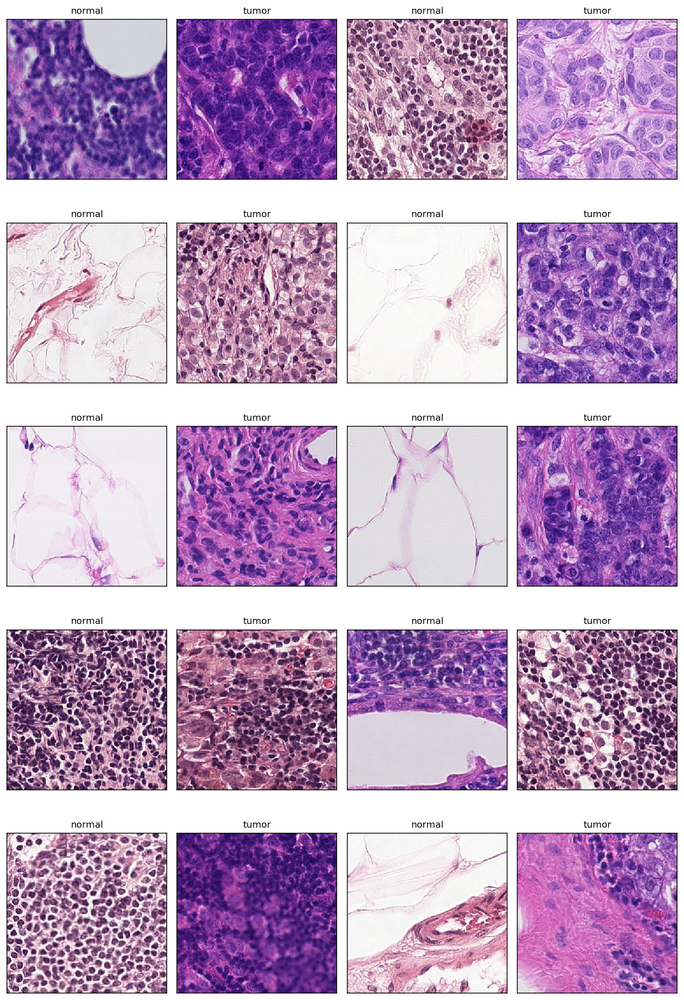

In [260]:
fig, axes = plt.subplots(5, 4, figsize=(10, 15), dpi=150)
for i in range(5):
    for j in range(2):
        ax = axes[i, 2 *j]
        ax.imshow(np.asarray(Image.open(patch_normal_list[i*20000+j*5000])))
        ax.set_title('normal')
        ax.axes.get_xaxis().set_visible(False)
        ax.axes.get_yaxis().set_visible(False)
        ax=axes[i, 2*j +1]
        ax.imshow(np.asarray(Image.open(patch_tumor_list[i*20000+j*5000])))
        ax.set_title('tumor')
        ax.axes.get_xaxis().set_visible(False)
        ax.axes.get_yaxis().set_visible(False)

plt.tight_layout()

In [345]:
# alternatively, run this script to view more images
# fig, axes = plt.subplots(4, 4, figsize=(8, 8), dpi=150)
# axes = axes.flatten()
# for i in range(16):
#     ax = axes[i]
#     ax.imshow(np.asarray(Image.open(patch_normal_list[i*10000])))
# #         ax.set_title('normal')
#     ax.axes.get_xaxis().set_visible(False)
#     ax.axes.get_yaxis().set_visible(False)

# plt.tight_layout()

# fig, axes = plt.subplots(4, 8, figsize=(16, 8), dpi=150)
# axes = axes.flatten()
# for i in range(32):
#     ax = axes[i]
#     ax.imshow(np.asarray(Image.open(patch_tumor_list[i*10000])))
# #         ax.set_title('tumor')
#     ax.axes.get_xaxis().set_visible(False)
#     ax.axes.get_yaxis().set_visible(False)

# plt.tight_layout()

#### optional: verify no broken image

In [21]:
from joblib import Parallel, delayed
def verify_patch(file_path):
    try:
        v_image = Image.open(file_path)
        v_image.verify()
        return False
    except:
        return True

In [22]:
out = Parallel(n_jobs=64, verbose=5)(delayed(verify_patch)(file_path)
                                     for file_path in patch_normal_list)
verified = np.asarray(out)
verified.sum()

[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    9.6s
[Parallel(n_jobs=64)]: Done 172 tasks      | elapsed:   10.0s
[Parallel(n_jobs=64)]: Done 496 tasks      | elapsed:   10.3s
[Parallel(n_jobs=64)]: Done 892 tasks      | elapsed:   10.6s
[Parallel(n_jobs=64)]: Done 1360 tasks      | elapsed:   11.1s
[Parallel(n_jobs=64)]: Done 1900 tasks      | elapsed:   11.6s
[Parallel(n_jobs=64)]: Done 2512 tasks      | elapsed:   12.1s
[Parallel(n_jobs=64)]: Done 3196 tasks      | elapsed:   12.7s
[Parallel(n_jobs=64)]: Done 3952 tasks      | elapsed:   13.4s
[Parallel(n_jobs=64)]: Done 4780 tasks      | elapsed:   14.1s
[Parallel(n_jobs=64)]: Done 5680 tasks      | elapsed:   15.0s
[Parallel(n_jobs=64)]: Done 6652 tasks      | elapsed:   15.9s
[Parallel(n_jobs=64)]: Done 7696 tasks      | elapsed:   16.8s
[Parallel(n_jobs=64)]: Done 8812 tasks      | elapsed:   17.8s
[Parallel(n_jobs=64)]: Done 10000 tasks      

0

In [23]:
out = Parallel(n_jobs=64, verbose=5)(delayed(verify_patch)(file_path)
                                     for file_path in patch_tumor_list)
verified = np.asarray(out)
verified.sum()

[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=64)]: Done 768 tasks      | elapsed:    1.5s
[Parallel(n_jobs=64)]: Done 3978 tasks      | elapsed:    4.7s
[Parallel(n_jobs=64)]: Done 5693 tasks      | elapsed:    6.3s
[Parallel(n_jobs=64)]: Done 6863 tasks      | elapsed:    7.6s
[Parallel(n_jobs=64)]: Done 8213 tasks      | elapsed:    9.0s
[Parallel(n_jobs=64)]: Done 9743 tasks      | elapsed:   10.6s
[Parallel(n_jobs=64)]: Done 11453 tasks      | elapsed:   12.4s
[Parallel(n_jobs=64)]: Done 13343 tasks      | elapsed:   14.3s
[Parallel(n_jobs=64)]: Done 15413 tasks      | elapsed:   16.5s
[Parallel(n_jobs=64)]: Done 17663 tasks      | elapsed:   18.8s
[Parallel(n_jobs=64)]: Done 20093 tasks      | elapsed:   21.2s
[Parallel(n_jobs=64)]: Done 22703 tasks      | elapsed:   23.9s
[Parallel(n_jobs=64)]: Done 25493 tasks      | elapsed:   26.6s
[Parallel(n_jobs=64)]: Done 28463 ta

0

# 1.4. Prepare the tfrecord dataset

In [295]:
num_tumor_patch = len(patch_tumor_list)
print('number of tumor patches: ', num_tumor_patch)
num_normal_patch = len(patch_normal_list)
print('number of normal patches:', num_normal_patch)

number of tumor patches:  311602
number of normal patches: 632200


In [296]:
random.seed(51)
# shuffle the list
random.shuffle(patch_normal_list)
random.shuffle(patch_tumor_list)
# take a look a the paths
patch_normal_list[:5]

['/media/boxi/Dataset/CAMELYON16/patch256/normal/1_85_248_145.png',
 '/media/boxi/Dataset/CAMELYON16/patch256/normal/1_73_127_269.png',
 '/media/boxi/Dataset/CAMELYON16/patch256/normal/1_107_246_140.png',
 '/media/boxi/Dataset/CAMELYON16/patch256/normal/1_103_441_138.png',
 '/media/boxi/Dataset/CAMELYON16/patch256/normal/1_50_107_612.png']

In [297]:
# train-test split
from sklearn.model_selection import train_test_split

num_per_class = num_tumor_patch * 2

patch_path_list = patch_normal_list[:num_per_class] + patch_tumor_list*2

labels = [0] * num_per_class + [1] * num_per_class

combined_patch_path_list = list(zip(patch_path_list, labels))
random.shuffle(combined_patch_path_list)
patch_path_list, labels = zip(*combined_patch_path_list)

patch_paths_train, patch_paths_val, labels_train, labels_val = train_test_split(
    patch_path_list, labels, test_size=0.01, random_state=51, shuffle=True)

len(patch_paths_train), len(patch_paths_val), len(
    labels_train), len(labels_val)

(1233943, 12465, 1233943, 12465)

In [298]:
def preprocess_for_storage(path):
    """
    load a image from file
    return image of type unint8
    """
    image = tf.io.read_file(path)
    image = tf.image.decode_png(image, channels=3, dtype=tf.uint8)
    image = tf.reshape(image, [256, 256, 3])
    return image

# img_path = patch_paths_train[0]
# preprocess_for_storage(img_path)


def load_and_preprocess_image(path):
    """
    load a image from file and normalize to [-1,1] range
    return image of type float32
    """
    image = tf.io.read_file(path)
    image = tf.image.decode_png(image, channels=3)
    image = tf.image.resize(image, [256, 256])
    image = image/127.5-1  # normalize to [-1,1] range
    return image

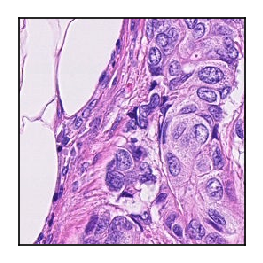

In [308]:
# example of reading an training image
patch_idx = 223
img_path = patch_path_list[patch_idx]
plt.figure(figsize=(2, 2),dpi=150)
plt.imshow(load_and_preprocess_image(img_path)*0.5+0.5)
plt.grid(False)
plt.xticks([])
plt.yticks([])
# plt.title(['normal', 'tumor'][labels[patch_idx]])
print()

In [10]:
image_ds_train = tf.data.Dataset.from_tensor_slices(
    tf.cast(patch_paths_train, tf.string)).map(preprocess_for_storage)  # .batch(5)#.map(tf.io.serialize_tensor)
image_ds_train

<MapDataset shapes: (256, 256, 3), types: tf.uint8>

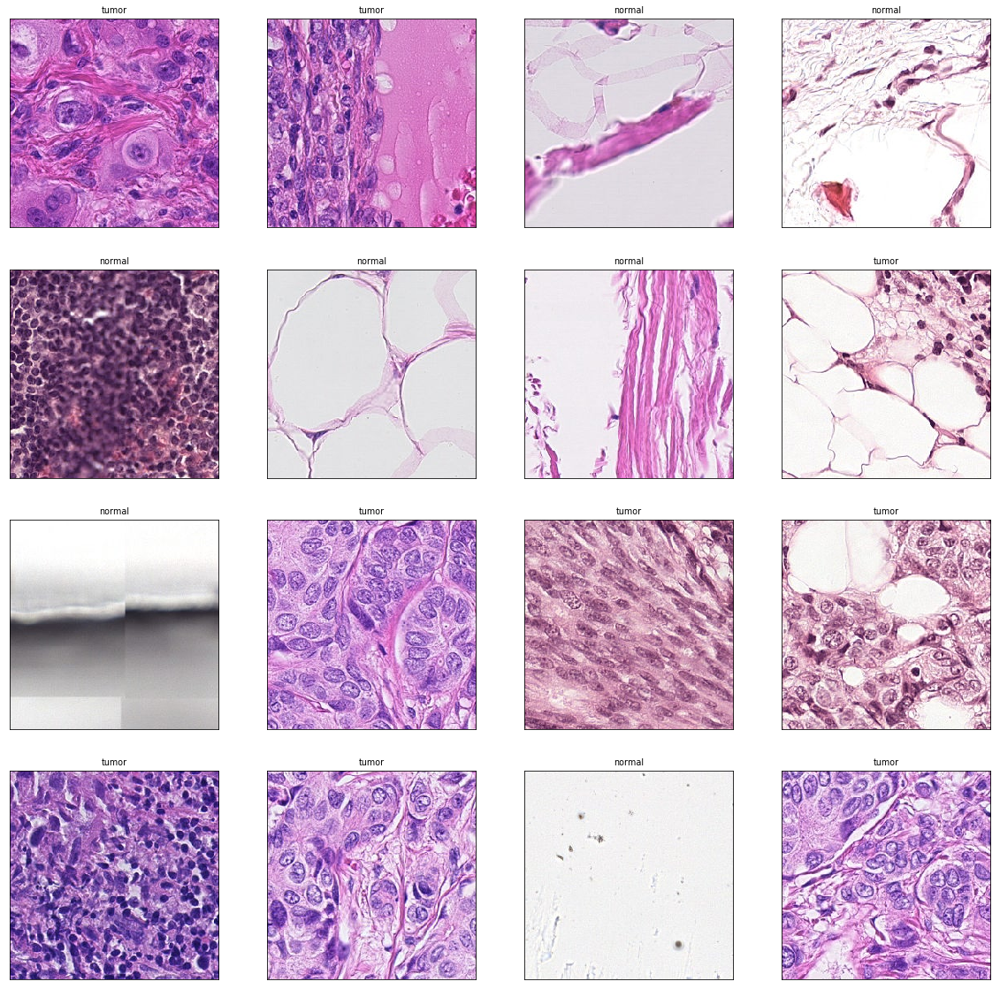

In [11]:
plt.figure(figsize=(20, 20))
for n, image in enumerate(image_ds_train.take(16)):
    plt.subplot(4, 4, n+1)
    plt.imshow(image.numpy())
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    plt.title(['normal', 'tumor'][labels_train[n]])

# 1.5. build tfrecord dataset

In [12]:
TF_DATASET_DIR = DATASET_DIR + '/patch256/'
TF_DATASET_DIR

'/media/boxi/Dataset/CAMELYON16/patch256/'

In [13]:
# saving labels numpy array 
np.save(TF_DATASET_DIR+'labels_train', labels_train)
np.save(TF_DATASET_DIR+'labels_val', labels_val)

# saving images tfrecords
image_ds_train = tf.data.Dataset.from_tensor_slices(
    tf.cast(patch_paths_train, tf.string)).map(preprocess_for_storage).map(tf.io.serialize_tensor)
tfrec = tf.data.experimental.TFRecordWriter(
    TF_DATASET_DIR+'images_train.tfrec')
tfrec.write(image_ds_train)

image_ds_val = tf.data.Dataset.from_tensor_slices(
    tf.cast(patch_paths_val, tf.string)).map(preprocess_for_storage).map(tf.io.serialize_tensor)
tfrec = tf.data.experimental.TFRecordWriter(TF_DATASET_DIR+'images_val.tfrec')
tfrec.write(image_ds_val)

# 2. Training

## 2.1. load TF dataset

In [1]:
# run cell#1
from IPython.display import Javascript
Javascript("Jupyter.notebook.execute_cells([1])")

<IPython.core.display.Javascript object>

In [287]:
import random
import tensorflow as tf
from tensorflow.keras.applications.xception import Xception
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2
from tensorflow.keras.layers import Conv2D, Dense, Dropout, Flatten
from tensorflow.keras.layers import MaxPooling2D, InputLayer, BatchNormalization
from tensorflow.keras.models import Sequential
from tensorflow.keras.callbacks import EarlyStopping
import os
import numpy as np
import matplotlib.pyplot as plt


TF_DATASET_DIR = DATASET_DIR + '/patch256/'


labels_train = np.load(TF_DATASET_DIR+'labels_train.npy')
label_ds_train = tf.data.Dataset.from_tensor_slices(
    tf.cast(labels_train, tf.int64))


labels_val = np.load(TF_DATASET_DIR+'labels_val.npy')
label_ds_val = tf.data.Dataset.from_tensor_slices(
    tf.cast(labels_val, tf.int64))


def parse_from_dataset(x):
    """
    load a image from tfrecord dataset and normalize to [-1,1] range
    return image of type float32 
    Input: x (tfrecord)
    """
    image = tf.io.parse_tensor(x, out_type=tf.uint8)
    image = tf.cast(image, tf.float32)
    image = tf.reshape(image, [256, 256, 3])
    image = image/127.5-1  # normalize to [-1,1] range

    return image

# parsing and data augmentation
def parse_from_dataset_and_augment(x):
    """
    load a image from tfrecord dataset, augment and normalize to [-1,1] range
    return image of type float32 
    Input: x (tfrecord)
    """
    image = tf.io.parse_tensor(x, out_type=tf.uint8)
    image = tf.reshape(image, [256, 256, 3])
    image = tf.image.rot90(image, random.randint(0, 3)
                           )  # rotate the image randomly
    image = tf.image.random_flip_left_right(image)

    image = tf.image.random_hue(image, 0.08)
    image = tf.image.random_saturation(image, 0.92, 1.08)
    image = tf.image.random_contrast(image, 0.92, 1.08)
    image = tf.image.random_brightness(image, 0.08)

    image = tf.cast(image, tf.float32)
    image = image/127.5-1  # normalize to [-1,1] range

    return image


image_ds_train = tf.data.TFRecordDataset(TF_DATASET_DIR+'images_train.tfrec').map(
    parse_from_dataset_and_augment, num_parallel_calls=tf.data.experimental.AUTOTUNE)


image_ds_val = tf.data.TFRecordDataset(TF_DATASET_DIR+'images_val.tfrec').map(
    parse_from_dataset, num_parallel_calls=tf.data.experimental.AUTOTUNE)
image_ds_train

<ParallelMapDataset shapes: (256, 256, 3), types: tf.float32>

Note:
The data augmentation applied to each patch of the training image is:
+ random rotation of 0,90,180,270 degrees
+ random flip left or right
+ random hue: delta=0.08
+ random saturation: delta=0.08
+ random contrast: delta=0.08
+ random brightness: delta=0.08

After that the image is converted to float32 and normalized to [-1,1]

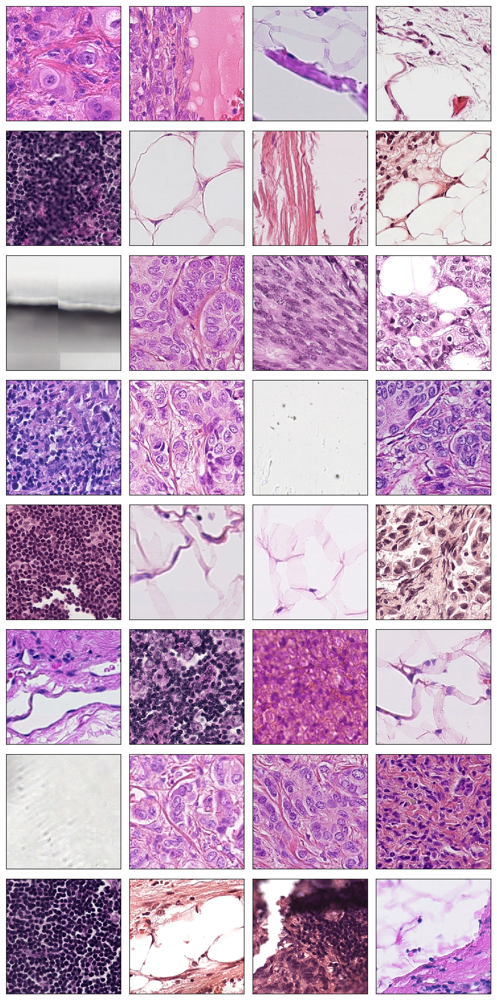

In [341]:
# take a look at the augmented training images
plt.figure(figsize=(10, 20), dpi=150)
for n, (label, image) in enumerate(zip(label_ds_train.take(32), image_ds_train.take(32))):
    plt.subplot(8, 4, n+1)
    plt.imshow(image.numpy()*0.5+0.5)
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
#     plt.title(['normal', 'tumor'][label.numpy()])
plt.tight_layout()

In [4]:
# using MirroredStrategy to train larger batch
strategy = tf.distribute.MirroredStrategy()
print('Number of devices: {}'.format(strategy.num_replicas_in_sync))

Number of devices: 2


In [6]:
BATCH_SIZE = 128*strategy.num_replicas_in_sync
# BATCH_SIZE = 64
ds_train = tf.data.Dataset.zip(
    (image_ds_train, label_ds_train)).apply(tf.data.experimental.shuffle_and_repeat(128)).batch(
    BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)

# ds_val = tf.data.Dataset.zip((image_ds_val, label_ds_val)).repeat().batch(
#     BATCH_SIZE).prefetch(tf.data.experimental.AUTOTUNE)

ds_train

<PrefetchDataset shapes: ((None, 256, 256, 3), (None,)), types: (tf.float32, tf.int64)>

(256, 256, 256, 3) (256,)


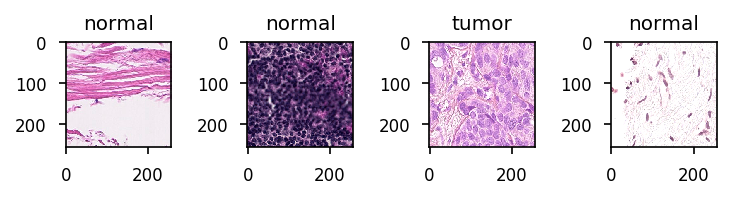

In [7]:
# take a look at the ds_train
for x in ds_train.take(1):
    # (images,labels)
    print(x[0].shape, x[1].shape)
    plt.figure(dpi=150, figsize=(5, 2))
    for k in range(4):
        plt.subplot(1, 4, k+1)
        plt.imshow(x[0][k].numpy()*0.5+0.5)
        plt.title(['normal', 'tumor'][x[1][k].numpy()])
    plt.tight_layout()

In [8]:
import gc
gc.collect()

6913

## 2.2. Define the DNN model

In [9]:
def decay(epoch):
    """
    learning rate decay function
    """
    if epoch < 80:
        return 1e-3
    elif epoch >= 80 and epoch < 120:
        return 1e-4
    else:
        return 1e-5

# Callback for printing the LR at the end of each epoch.
class PrintLR(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        print('\nLearning rate for epoch {0} is {1:.3e}'.format(epoch + 1,
                                                                model.optimizer.lr.numpy()))

callbacks = [
    tf.keras.callbacks.LearningRateScheduler(decay),
    PrintLR()
]

In [10]:
with strategy.scope():
    ####################### model #0 ###############################
    #     # Xception model with transfer learning
    #     conv_base = Xception(weights='imagenet', include_top=False,
    #                          input_shape=(256, 256, 3), pooling="avg")
    #     conv_base.trainable = True
    #     for layer in conv_base.layers[:-80]:
    #         layer.trainable = False
    #     for layer in conv_base.layers[-80:]:
    #         layer.trainable = True
    ###############################################################
    ####################### model #1 ###############################
    #     # Xception with selu activation instead of relu activation
    #     from XceptionCustom import XceptionCustom
    #     conv_base = XceptionCustom(include_top=False,
    #                                activation_name='selu',
    #                                input_shape=(256, 256, 3),
    #                                pooling="avg")
    ###############################################################
    ####################### model #2 ###############################
    #     # Xception training from scratch
    #     conv_base = Xception(weights=None, include_top=False,
    #                          input_shape=(256, 256, 3), pooling="avg")
    #     conv_base.trainable = True
    ###############################################################
    ####################### model #3 ###############################
    #     # MobileNetV2 training from scratch
    #     conv_base = MobileNetV2(alpha=1.5,weights=None, include_top=False,
    #                             input_shape=(256, 256, 3), pooling="avg")
    #     conv_base.trainable = True
    ###############################################################
    ########### model #4:  Resnet 50 with contave convolution #####
    import sys
    sys.path.append('./keras-octconv')
    from octave_resnet import OctaveResNet50
    conv_base = OctaveResNet50(input_shape=(256, 256, 3), include_top=False,
                               alpha=0.125, expansion=2,
                               initial_filters=36,
                               initial_strides=True,
                               pooling='avg')
    ###############################################################

    model = Sequential()
    model.add(conv_base)
    model.add(Flatten())

    ######### comment this section for baseline (model #6)#########
    model.add(Dense(256, activation='selu'))
    model.add(Dropout(0.2))
    model.add(Dense(256, activation='selu'))
    model.add(Dropout(0.2))
    ##############################################################  

    model.add(Dense(1, activation='sigmoid'))
    
    model.summary()
    
    model.compile(
        optimizer='adam',
        loss='binary_crossentropy',
        metrics=['acc'])



Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
OctaveResNet (Model)         (None, 576)               5331472   
_________________________________________________________________
flatten (Flatten)            (None, 576)               0         
_________________________________________________________________
dense (Dense)                (None, 256)               147712    
_________________________________________________________________
dropout (Dropout)            (None, 256)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               65792     
_________________________________________________________________
dropout_1 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2

In [28]:
# take a look at the convolutional base
tf.keras.utils.plot_model(model.layers[0], 'conv_base.png', show_shapes=True)

## 2.3. Training

In [11]:
# steps_per_epoch = tf.math.ceil(len(patch_path_list)/BATCH_SIZE).numpy() selu
steps_per_epoch = 100
EPOCHS = 150
history = model.fit(ds_train,
                    epochs=EPOCHS,
                    steps_per_epoch=steps_per_epoch,
                    callbacks=callbacks)  # ,class_weight=[1,10])

W0514 11:30:23.699674 140566656595776 distributed_training_utils.py:182] Your input callback is not one of the predefined Callbacks that supports DistributionStrategy. You might encounter an error if you access one of the model's attributes as part of the callback since these attributes are not set. You can access each of the individual distributed models using the `_grouped_model` attribute of your original model.
W0514 11:30:23.700732 140566656595776 distributed_training_utils.py:182] Your input callback is not one of the predefined Callbacks that supports DistributionStrategy. You might encounter an error if you access one of the model's attributes as part of the callback since these attributes are not set. You can access each of the individual distributed models using the `_grouped_model` attribute of your original model.


Epoch 1/150
 99/100 [============================>.] - ETA: 0s - loss: 0.4395 - acc: 0.8398
Learning rate for epoch 1 is 1.000e-03
100/100 [==============================] - 60s 603ms/step - loss: 0.4385 - acc: 0.8400
Epoch 2/150
 99/100 [============================>.] - ETA: 0s - loss: 0.3001 - acc: 0.8778
Learning rate for epoch 2 is 1.000e-03
100/100 [==============================] - 46s 455ms/step - loss: 0.2998 - acc: 0.8780
Epoch 3/150
 99/100 [============================>.] - ETA: 0s - loss: 0.2726 - acc: 0.8877
Learning rate for epoch 3 is 1.000e-03
100/100 [==============================] - 46s 457ms/step - loss: 0.2723 - acc: 0.8877
Epoch 4/150
 99/100 [============================>.] - ETA: 0s - loss: 0.2585 - acc: 0.8963
Learning rate for epoch 4 is 1.000e-03
100/100 [==============================] - 48s 476ms/step - loss: 0.2579 - acc: 0.8968
Epoch 5/150
 99/100 [============================>.] - ETA: 0s - loss: 0.2557 - acc: 0.8983
Learning rate for epoch 5 is 1.000e-

 99/100 [============================>.] - ETA: 0s - loss: 0.1056 - acc: 0.9633
Learning rate for epoch 75 is 1.000e-03
100/100 [==============================] - 47s 471ms/step - loss: 0.1052 - acc: 0.9635
Epoch 76/150
 99/100 [============================>.] - ETA: 0s - loss: 0.1098 - acc: 0.9623
Learning rate for epoch 76 is 1.000e-03
100/100 [==============================] - 47s 474ms/step - loss: 0.1102 - acc: 0.9622
Epoch 77/150
 99/100 [============================>.] - ETA: 0s - loss: 0.1027 - acc: 0.9640
Learning rate for epoch 77 is 1.000e-03
100/100 [==============================] - 48s 476ms/step - loss: 0.1024 - acc: 0.9641
Epoch 78/150
 99/100 [============================>.] - ETA: 0s - loss: 0.1048 - acc: 0.9638
Learning rate for epoch 78 is 1.000e-03
100/100 [==============================] - 47s 473ms/step - loss: 0.1046 - acc: 0.9639
Epoch 79/150
 99/100 [============================>.] - ETA: 0s - loss: 0.1034 - acc: 0.9637
Learning rate for epoch 79 is 1.000e-03


Epoch 149/150
 99/100 [============================>.] - ETA: 0s - loss: 0.0774 - acc: 0.9736
Learning rate for epoch 149 is 1.000e-05
100/100 [==============================] - 51s 514ms/step - loss: 0.0771 - acc: 0.9736
Epoch 150/150
 99/100 [============================>.] - ETA: 0s - loss: 0.0781 - acc: 0.9729
Learning rate for epoch 150 is 1.000e-05
100/100 [==============================] - 52s 520ms/step - loss: 0.0778 - acc: 0.9730


In [13]:
def plot_trainig_history(history):
    """
    visualize the training history
    """
    plt.figure(dpi=300, figsize=(5, 4))
    ax1 = plt.subplot(1, 1, 1)
    color = 'darkblue'
    ax1.plot(history['loss'], c=color, label='training loss')
    ax1.set_xlabel('epochs')
    ax1.set_ylabel('training loss', color=color)
    ax1.tick_params(axis='y', labelcolor=color)

    ax2 = ax1.twinx()
    color = 'darkred'
    ax2.plot(history['acc'], c=color, label='training accuracy')
    ax2.set_xlabel('epochs')
    ax2.set_ylabel('training accuracy', color=color)
    ax2.tick_params(axis='y', labelcolor=color)
    ax1.set_title('Training loss and accuracy')
    ax1.grid(True)
    plt.show()

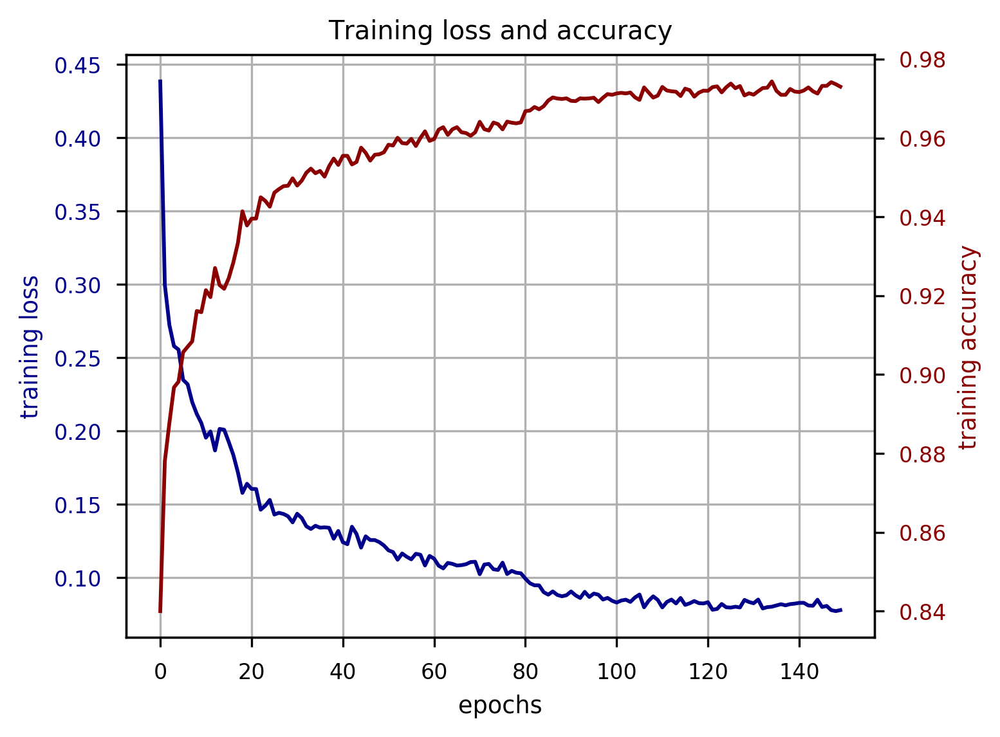

In [14]:
# For octresnet50
plot_trainig_history(history.history)

## 2.4. Save model and training history

In [13]:
# # save model and training history: xception followed by logistic regression (baseline)
# # trained from scratch, with batchsize = 32*3, steps_per_epochs = 100, epoches = 150
# import pickle
# pickle.dump(history.history,open( "model/model_xception_256_baseline_history.p", "wb" ))
# model.save("model/model_xception_256_baseline")
# tf.keras.utils.plot_model(model, 'model_xception_baseline.png', show_shapes=True)

In [49]:
# transfer learning
# # save model and training history: xception(lase 80 layers are trainable) with 3 dense layers
# # initialized with imagenet weight
# # trained with batchsize = 128*3, steps_per_epochs = 100, epoches = 50
# import pickle
# pickle.dump(history.history,open( "model/model_xception_256_50_transfer_history.p", "wb" ))
# model.save("model/model_xception_256_50_transfer")

In [14]:
# # save model and training history: mobilenetv2(alpha=1.5) with 3 dense layers
# # trained from scratch, with batchsize = 32*3, steps_per_epochs = 100, epoches = 150
# import pickle
# pickle.dump(history.history,open( "model/model_mobilenetv2_1.5_history.p", "wb" ))
# model.save("model/model_mobilenetv2_1.5")

In [12]:
# # save model and training history: xception with 3 dense layers
# # trained from scratch, with batchsize = 32*3, steps_per_epochs = 100, epoches = 150
# import pickle
# pickle.dump(history.history,open( "model/model_xception_256_0_history.p", "wb" ))
# model.save("model/model_xception_256_0")

In [12]:
# # save model and training history: xception(selu activation) with 3 dense layers
# # trained from scratch, with batchsize = 32*3, steps_per_epochs = 100, epoches = 150
# import pickle
# pickle.dump(history.history, open(
#     "model/model_xception_256_selu_history.p", "wb"))
# model.save("model/model_xception_256_selu")

In [16]:
# save model and training history: octresnet50
# trained from scratch, with batchsize = 128*2, steps_per_epochs = 100, epoches = 150
import pickle
pickle.dump(history.history, open(
    "model/model_octave_resnet50_history.p", "wb"))
model.save("model/model_octave_resnet50")

# 3. Validation
## 3.1. load trained model

In [1]:
# run cell#1
from IPython.display import Javascript
Javascript("Jupyter.notebook.execute_cells([1])")

<IPython.core.display.Javascript object>

In [3]:
# del model
# model = tf.keras.models.load_model("model/model_xception_256_50_transfer")
# model = tf.keras.models.load_model("model/model_xception_256_0")
model = tf.keras.models.load_model("model/model_mobilenetv2_1.5")
# model = tf.keras.models.load_model("model/model_xception_256_baseline")
# model = tf.keras.models.load_model("model/model_xception_256_selu")
# model = tf.keras.models.load_model("model/model_octave_resnet50")

In [310]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.50_256 (Model) (None, 1920)              4988528   
_________________________________________________________________
flatten (Flatten)            (None, 1920)              0         
_________________________________________________________________
dense (Dense)                (None, 256)               491776    
_________________________________________________________________
dropout (Dropout)            (None, 256)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 256)               65792     
_________________________________________________________________
dropout_1 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 2

## 3.2. predict on validation set

In [6]:
y_pred = model.predict(image_ds_val.batch(256, drop_remainder=False).prefetch(
    tf.data.experimental.AUTOTUNE), verbose=1)

     49/Unknown - 15s 300ms/step

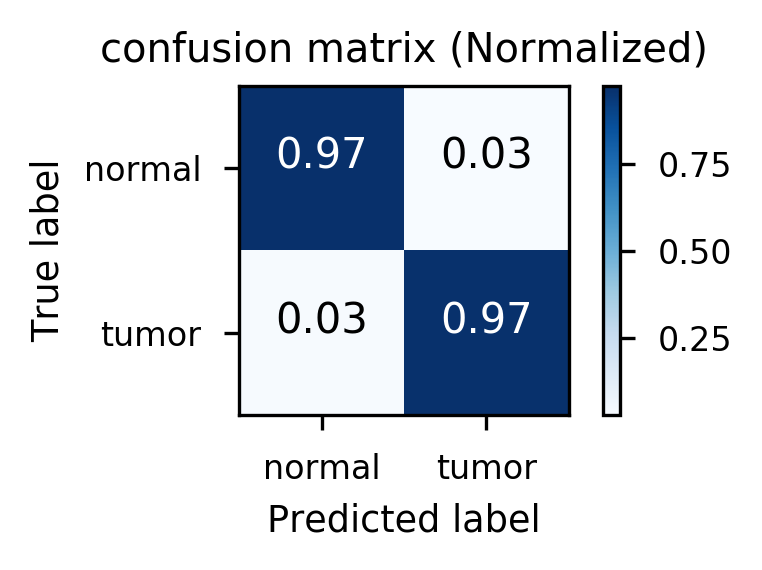

In [8]:
from sklearn.metrics import confusion_matrix

confusion_matrix_raw = confusion_matrix(
    labels_val[:max(y_pred.shape)], y_pred > 0.5)

plt.figure(figsize=(3, 2), dpi=300)
plot_confusion_matrix(confusion_matrix_raw, classes=['normal', 'tumor'],
                      normalize=True,
                      title_prefix="",
                      cmap=plt.cm.Blues)
plt.show()

In [9]:
ds_val = tf.data.Dataset.zip((image_ds_val, label_ds_val)).batch(
    512, drop_remainder=True).prefetch(tf.data.experimental.AUTOTUNE)
image_batch, label_batch = next(iter(ds_val))
y_pred_classes = model.predict_classes(
    image_batch, batch_size=256, verbose=1).ravel()

512/512 [==============================] - 1s 1ms/sample


In [10]:
def plot_prediction(images, labels, predicted_classes, indices):
    """
    visualize the prediction as subplots of (images,true_label,predicted_label)
    """
    #     plt.style.use('seaborn-talk')
    num_plots = len(indices)
    n_cols = 3
    n_rows = int(np.ceil(num_plots/n_cols))
    fig, ax = plt.subplots(
        n_rows, n_cols, figsize=(4*n_cols, 4*n_rows), dpi=300)
    ax = ax.ravel()
    k = 0
    for idx, image in zip(indices, images[indices]):
        ax[k].imshow(image*0.5+0.5)
        label = labels[idx]
        pred = predicted_classes[idx]
        color = 'r' if label != pred else 'k'
        ax[k].set_title("label: {0}, pred = {1}".format(
            label, pred), color=color)
        ax[k].grid(False)
        k += 1
    # remove extra axes
    for j in range(k, n_cols*n_rows):
        fig.delaxes(ax[j])
    plt.tight_layout()

### Examples of correct prediction:

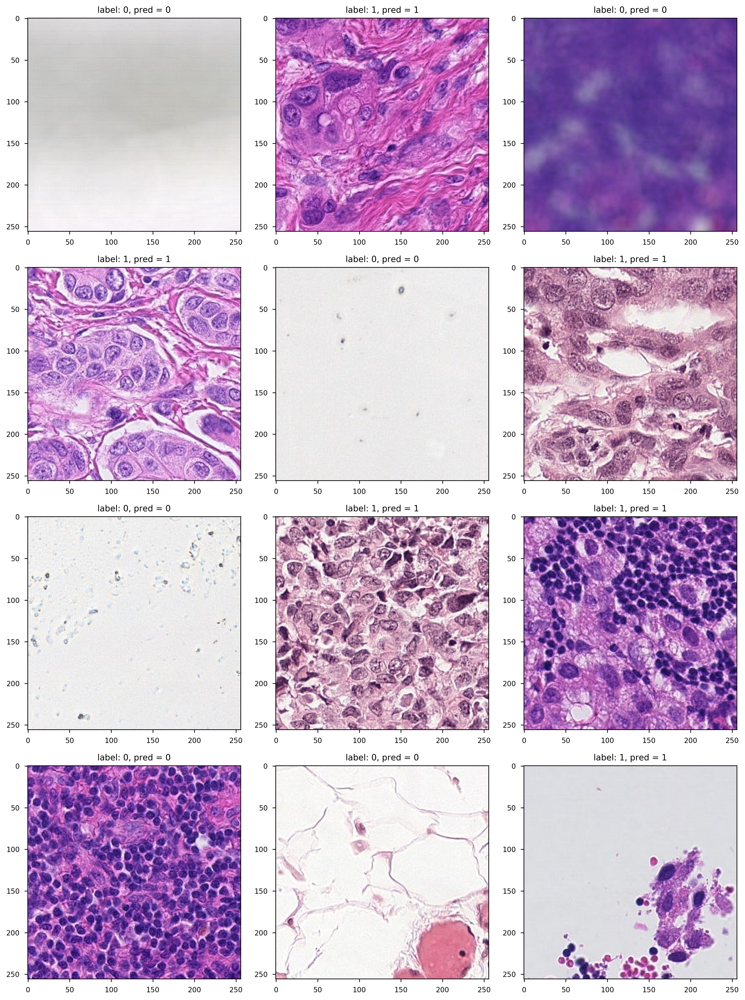

In [11]:
indices_right_prediction = np.where(
    y_pred_classes.ravel() == label_batch.numpy())[0]
plot_prediction(image_batch.numpy(), label_batch.numpy(),
                y_pred_classes, indices_right_prediction[:12])

### Examples of incorrect prediction:

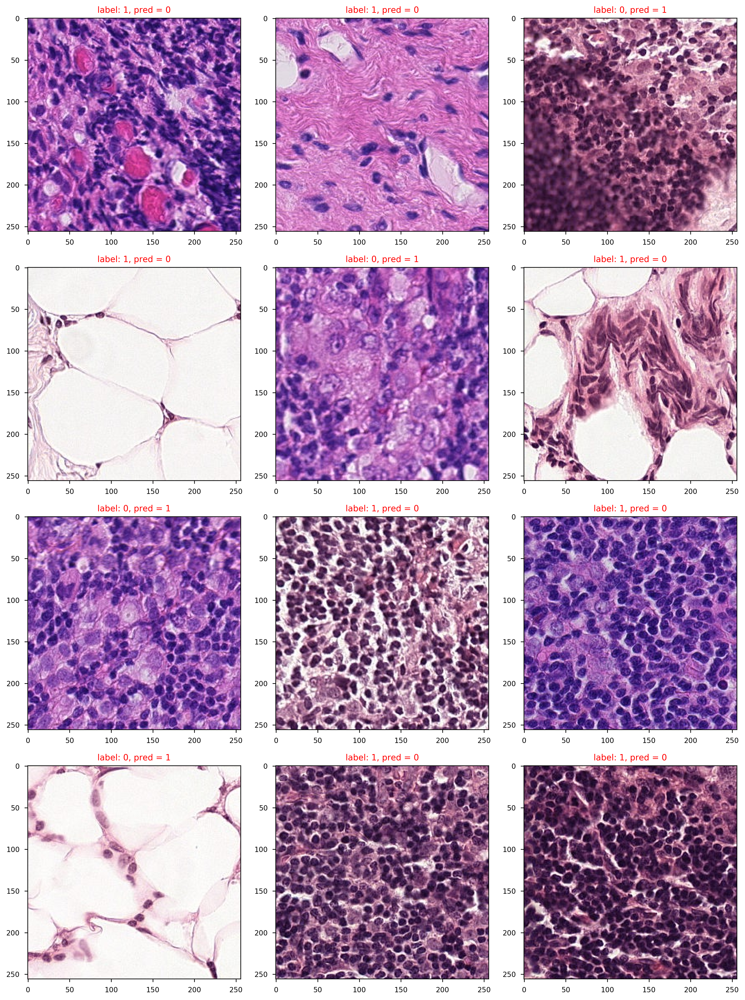

In [12]:
indices_wrong_prediction = np.where(
    y_pred_classes.ravel() != label_batch.numpy())[0]
plot_prediction(image_batch.numpy(), label_batch.numpy(),
                y_pred_classes, indices_wrong_prediction[:12])

### Comments:
Some incorrectly predicted images are blurred. We might be able to train better model if we have unblurred images.

# 4. Testing whole slide

In [13]:
from IPython.display import Javascript
Javascript("Jupyter.notebook.execute_cells([1])")  # run cell#1

<IPython.core.display.Javascript object>

## 4.1 Inspect the test slide

In [159]:
DATASET_DIR = "/media/boxi/V2/CAMELYON16"

TEST_DIR = DATASET_DIR+'/testing/'
slide_dir = TEST_DIR+'images/'
slide_annotation_dir = TEST_DIR+'lesion_annotations/'
tumor_mask_dir = TEST_DIR+'mask/'

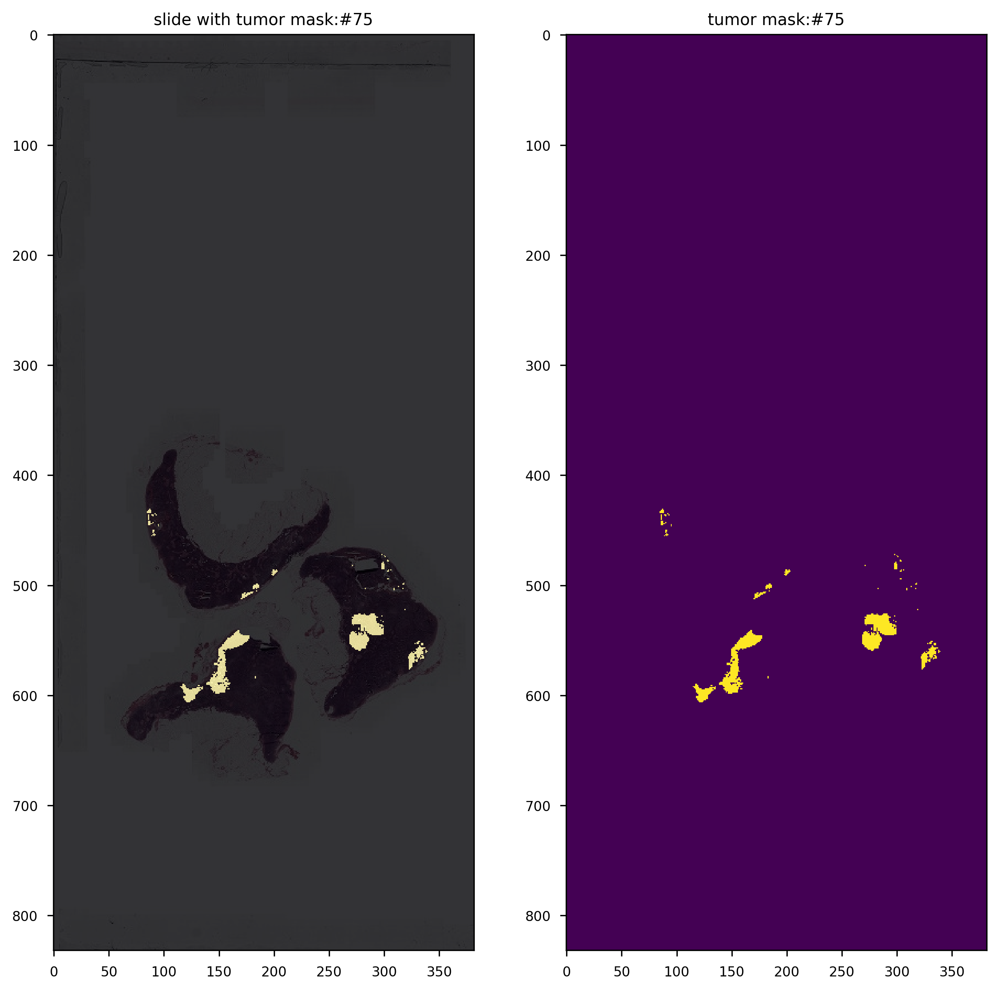

In [236]:
# 2,27,51,68,75,82,104
# 29,30,38,46,61,64,65,108
# for slide_no in [75]:
slide_no = 75
slide_basename = 'test_{:03}'.format(slide_no)

slide_path = slide_dir+slide_basename + '.tif'
tumor_mask_path = DATASET_DIR + '/testing/mask/'+slide_basename+".tif"
slide = open_slide(slide_path)
tumor_mask_slide = open_slide(tumor_mask_path)

level = 8

assert(tumor_mask_slide.level_count >= 9)
for k in range(tumor_mask_slide.level_count):
    assert(tumor_mask_slide.level_dimensions[k] == slide.level_dimensions[k])

#  read the entire mask at the same zoom level
# See https://openslide.org/api/python/#openslide.OpenSlide.read_region
# Note: x,y coords are with respect to level 0.
# There is an example below of working with coordinates
# with respect to a higher zoom level.
tumor_mask_image = read_slide(tumor_mask_slide,
                              x=0,
                              y=0,
                              level=level,
                              width=tumor_mask_slide.level_dimensions[level][0],
                              height=tumor_mask_slide.level_dimensions[level][1])

# Note: the program provided by the dataset authors generates a mask with R,G,B channels.
# The mask info we need is in the first channel only.
tumor_mask_image = tumor_mask_image[:, :, 0]

slide_image = read_slide(slide,
                         x=0,
                         y=0,
                         level=level,
                         width=slide.level_dimensions[level][0],
                         height=slide.level_dimensions[level][1])
fig, ax = plt.subplots(1, 2, figsize=(10, 10), dpi=300)

ax[0].imshow(slide_image)
ax[0].imshow(tumor_mask_image, alpha=0.8, cmap='inferno')
plt.gca().grid(False)

ax[0].set_title('slide with tumor mask:#{}'.format(slide_no))
ax[1].imshow(tumor_mask_image)
ax[1].set_title('tumor mask:#{}'.format(slide_no))

plt.gca().grid(False)
plt.show()

## 4.2 Prepare the patches from test slide

In [238]:
base_level = 1  # the smallest level where we look at the image
tissue_mask_level = base_level + 7  # the level where we decide if there is tissue
zoom = 2**base_level

# define a window for sliding through the entire slide
context_size = 256
center_size = 128
margin_size = (context_size - center_size)//2

In [239]:
def visualize_tissue(slide_image, tissue_mask, figsize=(5, 5), dpi=300):
    """
    display the slide image overlaid with tissue_mask and tissue_mask_morph
    """
    mask_visualization = np.zeros(
        (tissue_mask.shape[0], tissue_mask.shape[1], 4), dtype=float)
    mask_visualization[:, :, 1] = tissue_mask
    mask_visualization[:, :, 3] = 1 # alpha

    plt.figure(figsize=figsize, dpi=dpi)
    plt.imshow(np.zeros_like(tissue_mask), cmap='inferno', vmin=0, vmax=1)
    plt.imshow(slide_image)
    plt.imshow(mask_visualization,alpha=0.6, vmin=0, vmax=1)
    green_patch = mpatches.Patch(color=(0, 1, 0,0.6), label='tissue')
    plt.legend(handles=[green_patch], loc=4)
    plt.title("Visualize tissue mask")
    plt.grid(False)
    return plt.gca

58672 tissue pixels (18.5% of the image)


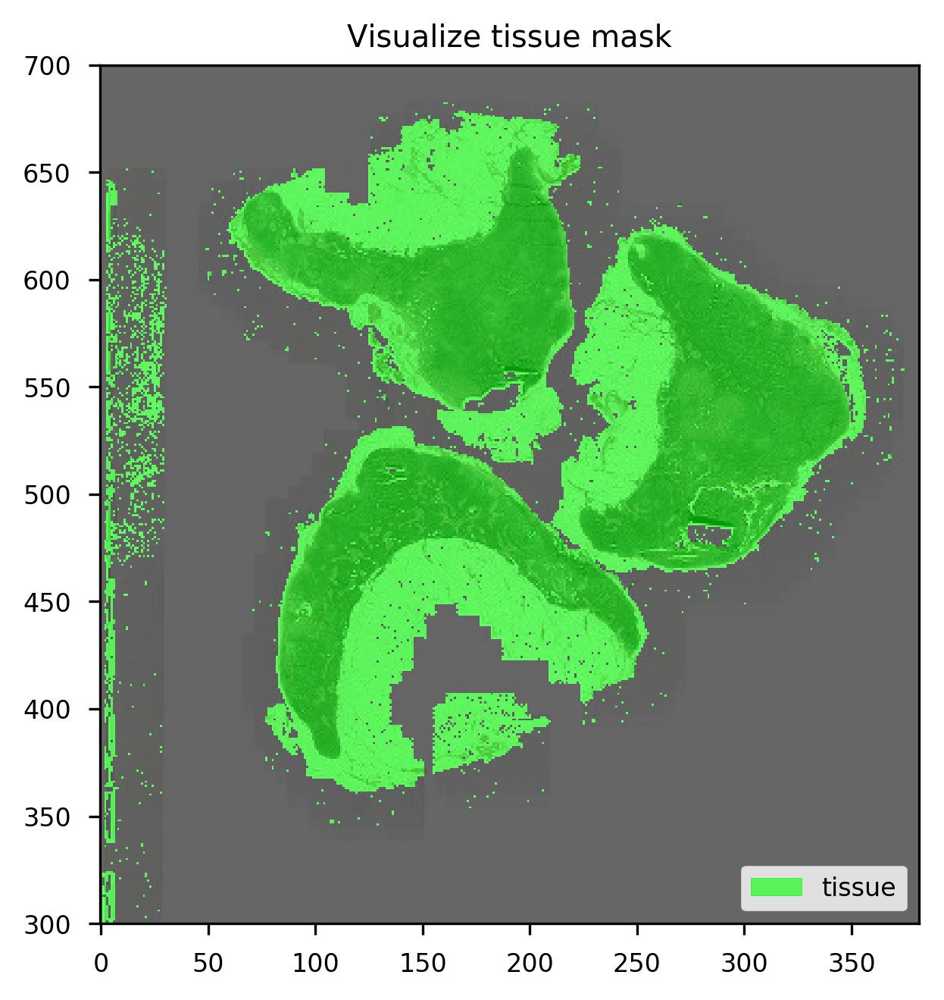

In [331]:
slide_image = get_slide_image(slide, tissue_mask_level)
tissue_mask = get_tissue_mask(slide, base_level, level_up=3)
tumor_mask_image = get_tumor_mask(tumor_mask_slide, base_level, level_up=3)

# visualize_slide(slide_image, tissue_mask, tumor_mask_image, dpi=200)
# plt.figure()
visualize_tissue(slide_image, tissue_mask)
plt.ylim((300,700))

len_tissue_pixels = tissue_mask.sum()
percent_tissue = len_tissue_pixels / \
    (tissue_mask.shape[0] * tissue_mask.shape[1]) * 100
print("%d tissue pixels (%.1f%% of the image)" %
      (len_tissue_pixels, percent_tissue))

In [242]:
# parsing test slide into patches
from joblib import Parallel, delayed
def get_tissue_patch(slide_path, x, y, base_level, context_size):
    """
    return an patch of slide at base_level given x,y position at level 0
    Input:
        slide_path (str): the path of the whole slide
        x (int): x position at level 0
        y (int): y position at level 0
        base_level: the smallest level of interest
        context_size: the size of the patch
    """
    slide = open_slide(slide_path)
    context_image_0 = read_slide(slide,
                                 x=x,
                                 y=y,
                                 level=base_level,
                                 width=context_size,
                                 height=context_size)

    return context_image_0


out = Parallel(n_jobs=64, verbose=1)(
    delayed(get_tissue_patch)(slide_path,
                              (id_x*center_size - margin_size)*zoom,
                              (id_y*center_size - margin_size)*zoom,
                              base_level, context_size)
    for id_y, id_x in zip(*np.where(tissue_mask)))

[Parallel(n_jobs=64)]: Using backend LokyBackend with 64 concurrent workers.
[Parallel(n_jobs=64)]: Done  72 tasks      | elapsed:   36.5s
[Parallel(n_jobs=64)]: Done 322 tasks      | elapsed:   37.4s
[Parallel(n_jobs=64)]: Done 672 tasks      | elapsed:   38.6s
[Parallel(n_jobs=64)]: Done 1122 tasks      | elapsed:   40.0s
[Parallel(n_jobs=64)]: Done 1672 tasks      | elapsed:   41.8s
[Parallel(n_jobs=64)]: Done 2322 tasks      | elapsed:   44.0s
[Parallel(n_jobs=64)]: Done 3072 tasks      | elapsed:   46.4s
[Parallel(n_jobs=64)]: Done 3922 tasks      | elapsed:   49.2s
[Parallel(n_jobs=64)]: Done 4872 tasks      | elapsed:   52.3s
[Parallel(n_jobs=64)]: Done 5922 tasks      | elapsed:   55.6s
[Parallel(n_jobs=64)]: Done 7072 tasks      | elapsed:   59.4s
[Parallel(n_jobs=64)]: Done 8322 tasks      | elapsed:  1.1min
[Parallel(n_jobs=64)]: Done 9672 tasks      | elapsed:  1.1min
[Parallel(n_jobs=64)]: Done 11122 tasks      | elapsed:  1.2min
[Parallel(n_jobs=64)]: Done 12672 tasks    

In [243]:
x_test = out
x_test = np.asarray(x_test, dtype=np.float32)
x_test = x_test/127.5-1
%xdel out
np.save('x_test_075', x_test)

In [168]:
x_test = np.load('x_test_075.npy')

## 4.3 Predict on patches

In [22]:
# del model
# model = tf.keras.models.load_model("model/model_xception_256_50_transfer")
# model = tf.keras.models.load_model("model/model_xception_256_0")
# model = tf.keras.models.load_model("model/model_mobilenetv2_1.5")
# model = tf.keras.models.load_model("model/model_xception_256_baseline")
# model = tf.keras.models.load_model("model/model_xception_256_selu")
model = tf.keras.models.load_model("model/model_octave_resnet50")

In [244]:
# prediction
y_pred = model.predict(x_test, batch_size=256, verbose=1)

58672/58672 [==============================] - 72s 1ms/sample


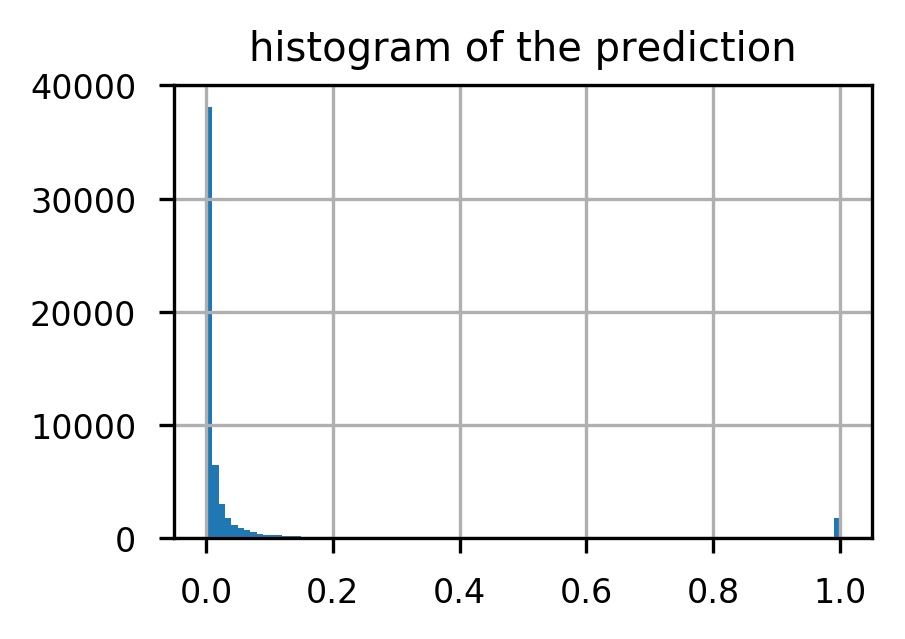

In [245]:
plt.figure(figsize=(3, 2), dpi=300)
plt.hist(y_pred, bins=100)
plt.grid(True)
plt.title('histogram of the prediction')
plt.show()

## 4.4 visualize the prediction

In [246]:
cut_off_probability = 0.5

tumor_mask_pred_prob = np.zeros(tumor_mask_image.shape, dtype=np.float32)
tumor_mask_pred_prob[tissue_mask] = y_pred.ravel()
tumor_mask_pred = tumor_mask_pred_prob > cut_off_probability

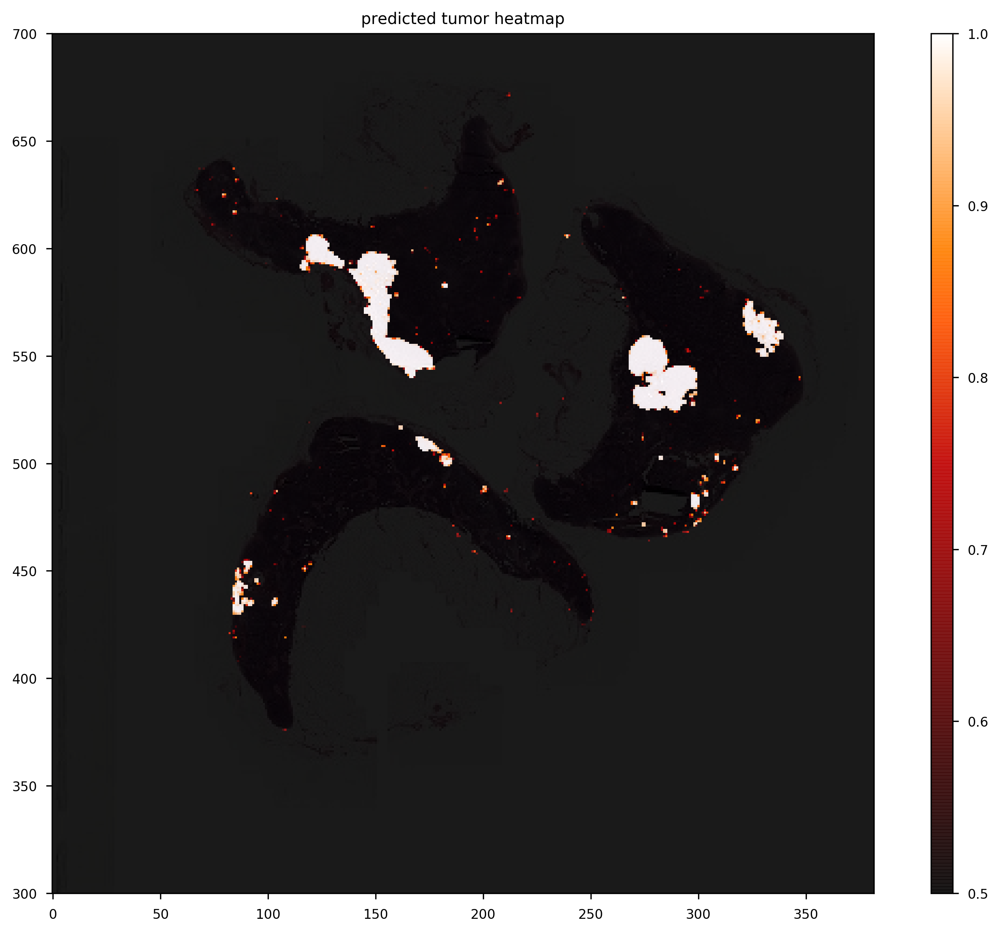

In [328]:
plt.figure(dpi=300, figsize=(10, 8))
plt.imshow(slide_image)
plt.imshow(tumor_mask_pred_prob, cmap='gist_heat',
           vmin=cut_off_probability, vmax=1, alpha=0.9)

plt.ylim((300,700))

plt.title('predicted tumor heatmap')
plt.colorbar(aspect=40,orientation='vertical')
plt.tight_layout()
plt.show()


## 4.5 test model performance

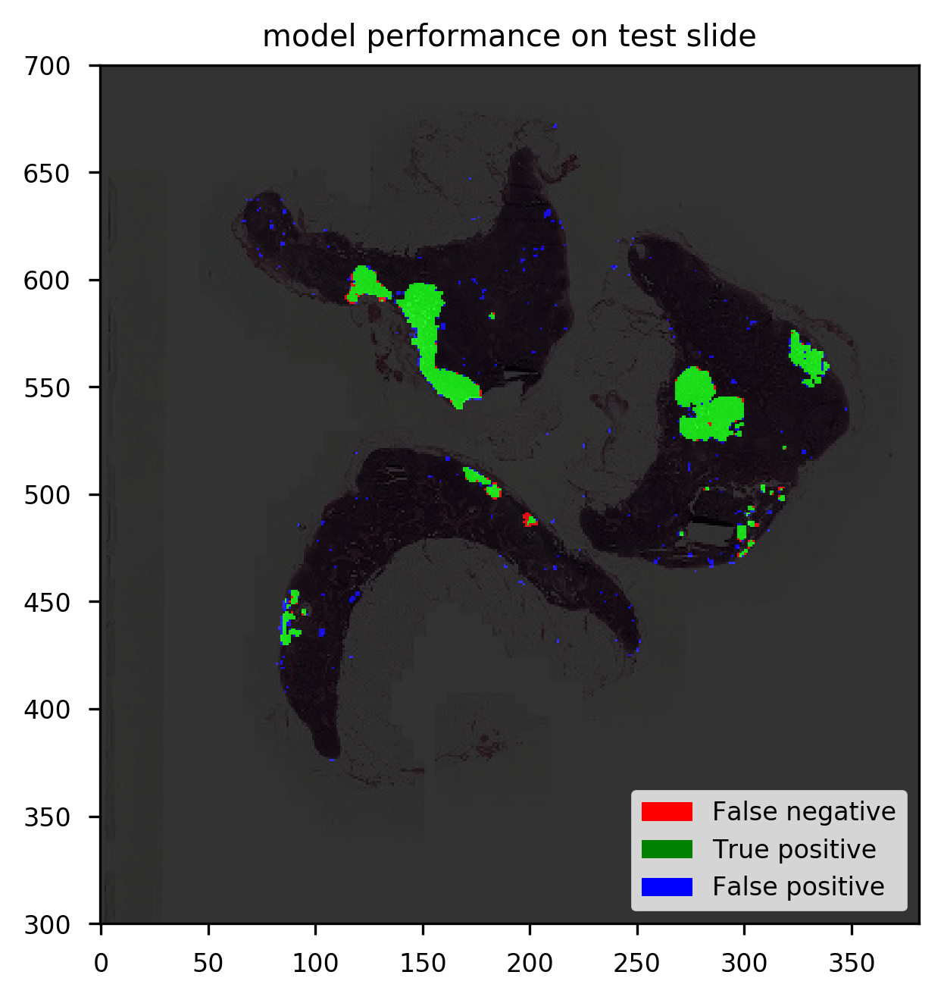

In [330]:
import matplotlib.patches as mpatches
figsize = (5, 5)
dpi = 300
mask_visualization = np.zeros(
    (tissue_mask.shape[0], tissue_mask.shape[1], 4), dtype=float)
mask_visualization[:, :, 1] = np.logical_and(
    tumor_mask_pred, tumor_mask_image)  # red for tumor
# green for interection(tumor,undetected tumor)
mask_visualization[:, :, 2] = np.logical_and(
    tumor_mask_pred, tumor_mask_image == False)
# blue for interection(predicted_tumor, healthy tissue)
mask_visualization[:, :, 0] = np.logical_and(
    tumor_mask_pred == False, tumor_mask_image)
mask_visualization[:, :, 3] = True

plt.figure(figsize=figsize, dpi=dpi)
plt.imshow(np.zeros_like(tissue_mask), cmap='inferno', vmin=0, vmax=1)
plt.imshow(slide_image)
plt.imshow(mask_visualization, alpha=0.8, vmin=0, vmax=1)

plt.ylim((300,700))

red_patch = mpatches.Patch(color='red', label='False negative')
blue_patch = mpatches.Patch(color='green', label='True positive')
yellow_patch = mpatches.Patch(color='blue', label='False positive')
plt.legend(handles=[red_patch, blue_patch, yellow_patch], loc=4)
plt.grid(False)
plt.title('model performance on test slide')
plt.show()

confusion_raw:
 [[315058    460]
 [   113   2193]]


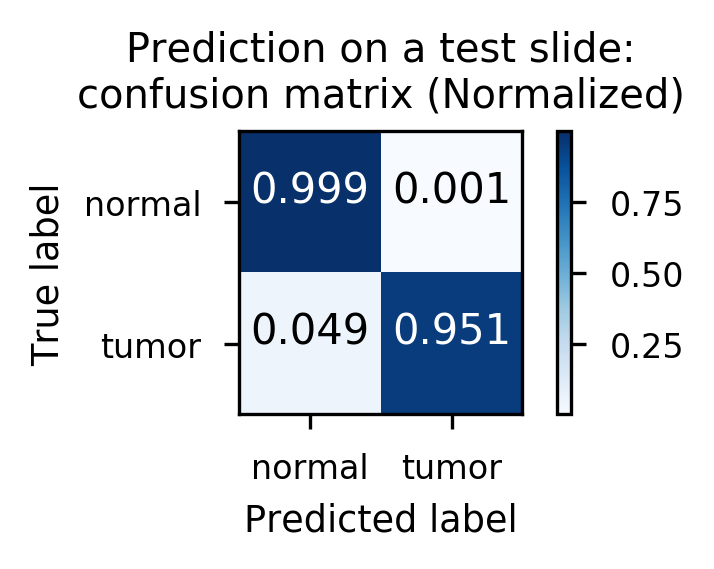

In [249]:
from sklearn.metrics import confusion_matrix

confusion_raw = confusion_matrix(
    tumor_mask_image.ravel(), tumor_mask_pred.ravel())
print("confusion_raw:\n",confusion_raw)

plt.figure(figsize=(3, 2), dpi=300)
plot_confusion_matrix(confusion_raw, classes=['normal', 'tumor'],
                      normalize=True,
                      title_prefix="Prediction on a test slide:\n",
                      cmap=plt.cm.Blues)
plt.show()

roc_auc_score= 0.9961639251012133


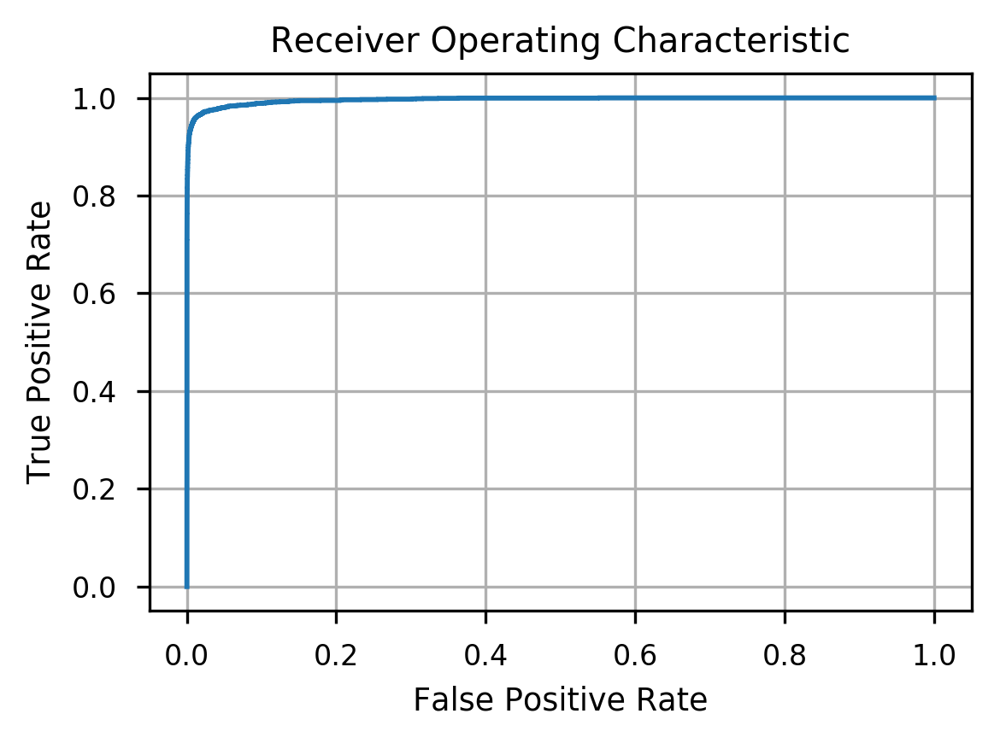

In [250]:
from sklearn.metrics import roc_curve, roc_auc_score
# Compute Receiver operating characteristic (ROC)
false_positive_rate, true_positive_rate, thresholds = roc_curve(
    tumor_mask_image[tissue_mask].ravel(), y_pred)
# Compute Area Under the Receiver Operating Characteristic Curve (ROC AUC) from prediction.
plt.figure(figsize=(4, 3), dpi=300)
plt.plot(false_positive_rate, true_positive_rate)
plt.title('Receiver Operating Characteristic')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.grid(True)
plt.tight_layout()
print('roc_auc_score=', roc_auc_score(
    tumor_mask_image[tissue_mask].ravel(), y_pred))

# Conclusion
We have build an end-to-end solution for automated detection of cancer on gigapixel whole slide. The model achives resonbably well accuracy on test slide.
# future work
The batch size influences how accurate mini-batch back propagation is. The xception can only be trained with small batch size, while the smaller mobilenetv2 and octaveconv-resnet50 model can be trained with larger batch size. Because of this, the smaller models perform as the bigger xception models. In the future we can try to try xception with larger batch size to see if we could inprove the xception model performance.
